# Analysis of RF/FSO Communication Systems under Different Weather Conditions Using Random Forest

##### YISHI XU
##### A1875057

## Background and Aim

Hybrid Radio Frequency/Free Space Optical (RF/FSO) systems the leverage respective advantages of radio and optical frequency communication channels. This dual-channel approach enhances data rates and link availability, making it a promising technology for future wireless communication systems, including satellite communications. The Australian Space Agency and NASA have emphasized the importance of hybrid RF/FSO satellite communications in their communication technology and services roadmaps. Despite the potential benefits in terms of channel capacity and system resilience, the performance of hybrid RF/FSO systems is significantly affected by weather conditions. For example, rainy weather can cause channel attenuation, thereby reducing the received signal power[1].

The report's primary goal is to develop models that describe attenuation, which is the power loss calculated as the difference between Transmit Signal Strength(TSS) and Receive Signal Strength(RSS). One model will focus on RF attenuation, while the other will address FSO attenuation[2].

In [1]:
import pandas as pd
import warnings
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import seaborn as sns
from scipy import stats
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder, PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance
from tqdm import tqdm
import joblib
import os
import psutil
import time
import plotly.graph_objs as go
import plotly.express as px
from joblib import Parallel, delayed
from plotly.subplots import make_subplots
import pickle

In [2]:
# To plot pretty figures directly within Jupyter, I set the global parameters for the aesthetics and clarity of the figures.
mpl.rc('axes', labelsize=14)  
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12) 

# Ignore all warnings
warnings.filterwarnings('ignore')

In [3]:
import sys

# Check Python version
sys.version

'3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]'

### 1. Read the dataset

In [4]:
# Load the dataset
data_path = 'RFLFSODataFull.csv'
data = pd.read_csv(data_path, on_bad_lines='skip')

# Remove all columns that start with 'Unnamed'
data = data.loc[:, ~data.columns.str.contains('^Unnamed')]

# Display the dataset
data

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMax,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin
0,7.913289,6.927868,17.595709,17.615907,17.340148,2115.338398,8.350000e+10,0.000000,0.0,0.000000,...,26.60303,24.680849,9.0,65884.518460,72336.362230,65617.543750,88.755450,3.057066,6.863808,3.007939
1,7.451176,4.412096,17.549693,17.572415,17.299439,2113.999257,7.350000e+10,0.000000,0.0,0.000000,...,26.377164,24.313108,9.0,64963.410920,68753.386150,60379.327480,99.790057,2.727910,6.468903,2.537393
2,7.072747,6.268740,17.290230,17.644014,16.037894,2118.689047,8.350000e+10,0.000000,0.0,0.000000,...,27.670822,23.150277,10.0,54794.281070,54821.773820,50850.155960,65.730085,1.674810,2.826916,1.640809
3,6.949288,4.317853,16.820880,17.066776,15.895622,2114.632339,7.350000e+10,0.000000,0.0,0.000000,...,26.5221,23.174815,10.0,50205.641590,52519.927530,45374.510900,88.127497,0.962068,2.780643,0.886951
4,7.361052,6.114514,16.813820,17.953974,15.227225,2116.786055,8.350000e+10,0.000000,0.0,0.000000,...,26.305736,24.864100,10.0,59038.325990,64418.329140,54461.246510,84.167414,1.881007,4.476298,1.874052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178711,9.150012,11.968291,23.283256,24.142871,22.169805,3970.846129,8.350000e+10,0.000000,0.0,0.000000,...,27.257926,26.013205,4.0,13041.847800,13458.340660,12411.852990,91.391749,0.000000,0.027596,0.000000
178712,9.333777,11.538030,23.259618,25.104895,21.005496,3969.230652,7.350000e+10,0.000000,0.0,0.000000,...,28.101044,25.032282,4.0,15959.633590,16232.735440,15345.485230,47.997946,0.075640,0.349551,0.069834
178713,8.873168,11.491891,23.331697,23.996130,22.148649,3968.373512,8.350000e+10,0.000000,0.0,0.000000,...,28.249678,26.205773,4.0,13129.663750,13948.560180,11925.979950,103.963102,0.052282,0.178062,0.049824
178714,9.538886,11.526529,21.241027,21.624932,20.736391,3967.550165,7.350000e+10,29.693160,30.76154,28.497137,...,26.880084,25.031934,5.0,15082.787860,15522.762220,14842.654290,82.090779,0.443520,1.838449,0.413146


In [5]:
# Calculate the number of missing values in each column
missing_values = data.isnull().sum()

# Display only columns that have missing values
print(missing_values[missing_values > 0])

AbsoluteHumidityMin      1
Distance                 1
Frequency                3
Particulate              3
ParticulateMax           3
ParticulateMin           3
RainIntensity            5
RainIntensityMax         5
RainIntensityMin         5
RelativeHumidity         5
SYNOPCode                5
Temperature              6
TemperatureDifference    6
TemperatureMax           6
TemperatureMin           6
Time                     6
Visibility               6
VisibilityMax            6
VisibilityMin            7
WindDirection            8
WindSpeed                8
WindSpeedMax             8
WindSpeedMin             8
dtype: int64


It is typical to first check the overall distribution of the raw data before proceeding with any processing. This assumes that there is a logical relationship between certain independent and dependent variables, or that there is a clear objective for analysing the data (e.g. a known significant relationship between time and FSO_Att). However, at present we have very limited knowledge of the original dataset. Directly identifying relationships between all independent and dependent variables would make the analysis process too redundant and risky in terms of system applicability. Therefore, it is not desirable to focus directly on the original data set. On the other hand, if we focus directly on individual variables, there will be many repetitive pre-processing steps that will make the analysis process redundant. After validation, we will discuss and explain in detail the data that show clear logical correlations.

In [6]:
# check for missing values
missing_values = data.isnull().sum()

# Display columns with missing values
print(missing_values[missing_values > 0])

# Filter and display rows with missing values in any column
rows_with_missing = data[data.isnull().any(axis=1)]
print(rows_with_missing)

AbsoluteHumidityMin      1
Distance                 1
Frequency                3
Particulate              3
ParticulateMax           3
ParticulateMin           3
RainIntensity            5
RainIntensityMax         5
RainIntensityMin         5
RelativeHumidity         5
SYNOPCode                5
Temperature              6
TemperatureDifference    6
TemperatureMax           6
TemperatureMin           6
Time                     6
Visibility               6
VisibilityMax            6
VisibilityMin            7
WindDirection            8
WindSpeed                8
WindSpeedMax             8
WindSpeedMin             8
dtype: int64
          FSO_Att       RFL_Att  AbsoluteHumidityAve  AbsoluteHumidityMax  \
16507   11.711310      5.925573            12.978836         40080.045960   
42155    2.601559     11.396876             2.710462             2.815839   
50738    4.844256     14.775694             7.462836             7.605516   
66886    2.254472      0.000000             0.321918      

It is observed that there are missing values in the dataset which are caused by 【】. They will be deleted during data processing to eliminate their impact on the data.

In [7]:
# Remove rows with missing values (this is done only once)
data_clean = data.dropna()

# Confirm no missing values remain
# This step checks if there are any remaining missing values, just for confirmation.
missing_values = data_clean.isnull().sum()

if missing_values.any():
    print("Remaining columns with missing values:")
    print(missing_values[missing_values > 0])
else:
    print("No missing values found in the cleaned data.")

No missing values found in the cleaned data.


In [8]:
# Display the first few rows of the cleaned data
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMax,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin
0,7.913289,6.927868,17.595709,17.615907,17.340148,2115.338398,8.350000e+10,0.000000,0.0,0.000000,...,26.60303,24.680849,9.0,65884.518460,72336.362230,65617.543750,88.755450,3.057066,6.863808,3.007939
1,7.451176,4.412096,17.549693,17.572415,17.299439,2113.999257,7.350000e+10,0.000000,0.0,0.000000,...,26.377164,24.313108,9.0,64963.410920,68753.386150,60379.327480,99.790057,2.727910,6.468903,2.537393
2,7.072747,6.268740,17.290230,17.644014,16.037894,2118.689047,8.350000e+10,0.000000,0.0,0.000000,...,27.670822,23.150277,10.0,54794.281070,54821.773820,50850.155960,65.730085,1.674810,2.826916,1.640809
3,6.949288,4.317853,16.820880,17.066776,15.895622,2114.632339,7.350000e+10,0.000000,0.0,0.000000,...,26.5221,23.174815,10.0,50205.641590,52519.927530,45374.510900,88.127497,0.962068,2.780643,0.886951
4,7.361052,6.114514,16.813820,17.953974,15.227225,2116.786055,8.350000e+10,0.000000,0.0,0.000000,...,26.305736,24.864100,10.0,59038.325990,64418.329140,54461.246510,84.167414,1.881007,4.476298,1.874052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178711,9.150012,11.968291,23.283256,24.142871,22.169805,3970.846129,8.350000e+10,0.000000,0.0,0.000000,...,27.257926,26.013205,4.0,13041.847800,13458.340660,12411.852990,91.391749,0.000000,0.027596,0.000000
178712,9.333777,11.538030,23.259618,25.104895,21.005496,3969.230652,7.350000e+10,0.000000,0.0,0.000000,...,28.101044,25.032282,4.0,15959.633590,16232.735440,15345.485230,47.997946,0.075640,0.349551,0.069834
178713,8.873168,11.491891,23.331697,23.996130,22.148649,3968.373512,8.350000e+10,0.000000,0.0,0.000000,...,28.249678,26.205773,4.0,13129.663750,13948.560180,11925.979950,103.963102,0.052282,0.178062,0.049824
178714,9.538886,11.526529,21.241027,21.624932,20.736391,3967.550165,7.350000e+10,29.693160,30.76154,28.497137,...,26.880084,25.031934,5.0,15082.787860,15522.762220,14842.654290,82.090779,0.443520,1.838449,0.413146


Examination of the data revealed that it was necessary to remove the categorical variables (Frequency, SYNOPCode, Time) and the variable Distance for potential categorical relationships in order to identify potential duplicates. In addition, a large number of data points with a value of 0 were identified. These are removed from the analysis along with the above data.

In [9]:
# Remove specified columns for duplicate check
temp_data = data.drop(columns=['Distance','Frequency', 'SYNOPCode', 'Time'])

# Remove rows where all data points are zero
temp_data = temp_data.loc[~(temp_data == 0).all(axis=1)]

# Check for duplicate rows in the modified dataframe
duplicates = temp_data.duplicated(keep=False)

# Display all duplicate rows based on the remaining columns and count them
if duplicates.any():
    # Find indexes of duplicates in original data to maintain all columns
    duplicate_indexes = temp_data[duplicates].index
    print("Duplicate rows found (after exclusions and removing zeros):")
    # Display duplicates from the original data for reference
    duplicate_rows = temp_data.loc[duplicate_indexes]
    # Display duplicate rows
    print(duplicate_rows)
    # Count the duplicate rows
    duplicate_count = duplicate_rows.shape[0]
    print(f"Total duplicate rows: {duplicate_count}")
else:
    print("No duplicate rows found.")

Duplicate rows found (after exclusions and removing zeros):
          FSO_Att    RFL_Att  AbsoluteHumidityAve  AbsoluteHumidityMax  \
4043    12.636832  10.406506            19.708797            21.645547   
4044    12.012471  13.180975            19.556770            21.127568   
4045    12.728805  11.008166            19.716571            20.846467   
4046    15.335209  12.023719            19.586916            20.560409   
4047    14.680296  10.428136            19.482548            21.110036   
...           ...        ...                  ...                  ...   
178711   9.150012  11.968291            23.283256            24.142871   
178712   9.333777  11.538030            23.259618            25.104895   
178713   8.873168  11.491891            23.331697            23.996130   
178714   9.538886  11.526529            21.241027            21.624932   
178715  11.290048  11.611650            20.876100            22.581643   

        AbsoluteHumidityMin  Particulate Particulat

Following the exclusion of the effect of categorical variables and the 0 variable, the dataset still exhibits a considerable number of duplicate values. Consequently, it is necessary to discuss the respective causes and rationale for the duplicates as the data is analysed and processed.

### 2. data cleaning

The dataset is divided into two distinct categories: independent variables and dependent variables. The independent variables are further subdivided into two subcategories: continuous variables and categorical variables. We will explicitly define each variable and will provide a comprehensive overview of the cleaning and categorisation process for each set of variables.

#### 2.1 response variable

FSO_Att/RFL_Att(Column1-2): 'FSO_Att (Free Space Optical Attenuation)' and 'RF_Att (Radio Frequency Attenuation)' are defined as the measures of signal power loss experienced in free space optical and radio frequency transmission paths, respectively.

Obtain the FSO_Att and RFL_Att data and arrange them in ascending order. Plot the bar chart, line chart and box plot for each data set, respectively.

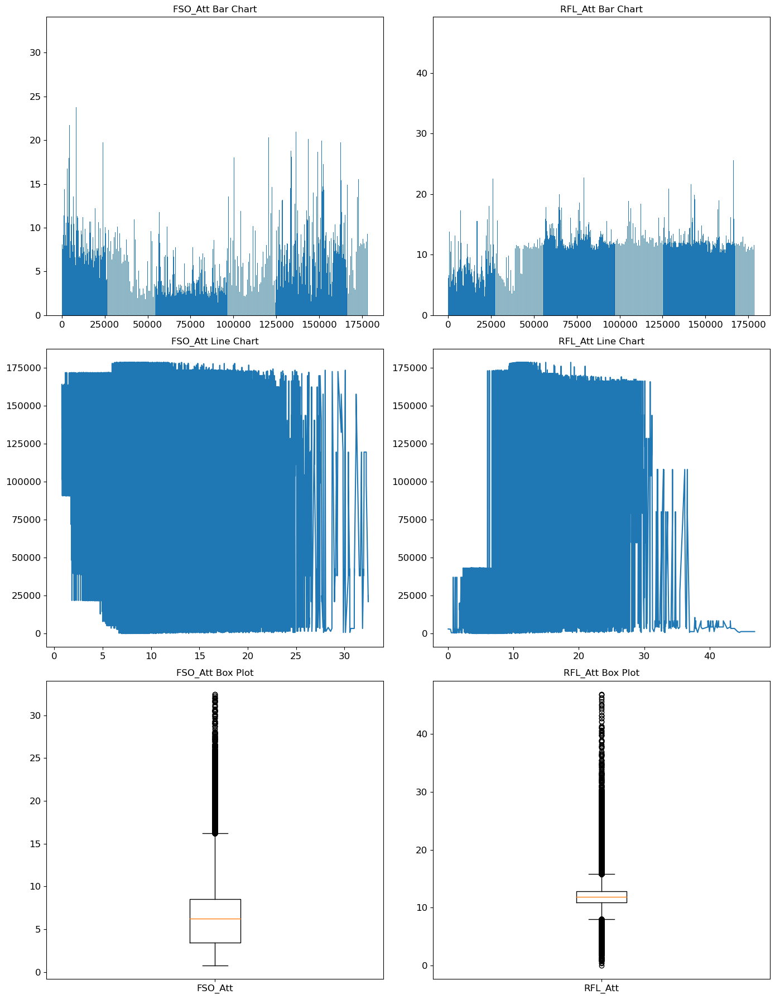

In [10]:
# Select and sort the columns
fso_data = data_clean['FSO_Att'].sort_values()
rfl_data = data_clean['RFL_Att'].sort_values()

# Create a figure and a set of subplots
fig, axs = plt.subplots(3, 2, figsize=(14, 18))

# Plotting Bar Charts
axs[0, 0].bar(fso_data.index, fso_data)
axs[0, 0].set_title('FSO_Att Bar Chart')
axs[0, 1].bar(rfl_data.index, rfl_data)
axs[0, 1].set_title('RFL_Att Bar Chart')

# Plotting Line Charts
axs[1, 0].plot(fso_data, fso_data.index)
axs[1, 0].set_title('FSO_Att Line Chart')
axs[1, 1].plot(rfl_data, rfl_data.index)
axs[1, 1].set_title('RFL_Att Line Chart')

# Plotting Box Plots
axs[2, 0].boxplot(fso_data)
axs[2, 0].set_title('FSO_Att Box Plot')
axs[2, 0].set_xticks([1], ['FSO_Att'])
axs[2, 1].boxplot(rfl_data)
axs[2, 1].set_title('RFL_Att Box Plot')
axs[2, 1].set_xticks([1], ['RFL_Att'])

# Display the plots
plt.tight_layout()
plt.show()

From our histogram of FSO and RF attenuation, it is clear that FSO_Att is roughly distributed in the range 0-20, while RF_Att is in the range below 0-15. Based on the ordinal ordering, similar attenuation results are clearly concentrated in some intervals, which is very significant direct evidence of higher importance weights for the categorical variables, and we will find out which categorical variables these distributions specifically depend on in the course of subsequent data analyses.

The line plots roughly confirm the results of the bar plots, and the distribution of the data largely fits. In the box plots, however, there are a considerable number of outliers, and since we must first determine the relationship of the data to the categorical variables, we cannot deal with these outliers in the first place, since it is clear that our data do not present a uniform distribution assumption, such as a normal distribution.

In the next step, we will clean the variables separately.

#### 2.2 categorical variables

Distance(Column6): 'Distance' refers to the separation between pairs from 6 different cities.

Plot histograms and line graphs of distance on ordinal numbers.

Text(0, 0.5, 'Distance')

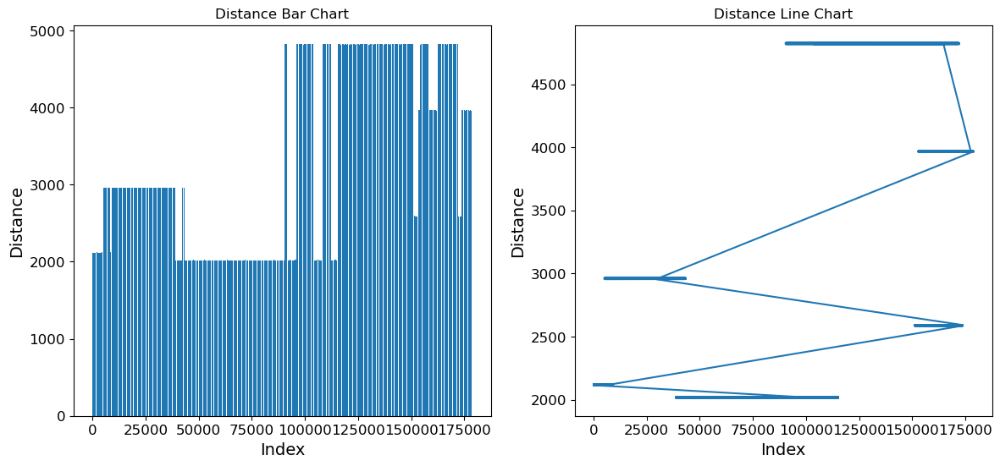

In [11]:
# Select and sort the Distance column 
distance = data_clean['Distance']
distance_sorted = distance.sort_values()

# Create a figure and a set of subplots
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Plotting Bar Chart for Distance
axs[0].bar(distance.index, distance)
axs[0].set_title('Distance Bar Chart')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Distance')

# Plotting Line Chart for Distance
axs[1].plot(distance_sorted.index, distance_sorted)
axs[1].set_title('Distance Line Chart')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Distance')

From the bar chart we can clearly see the different and concentrated distance data from the six cities. We can clearly see this concentration trend in the line graph.

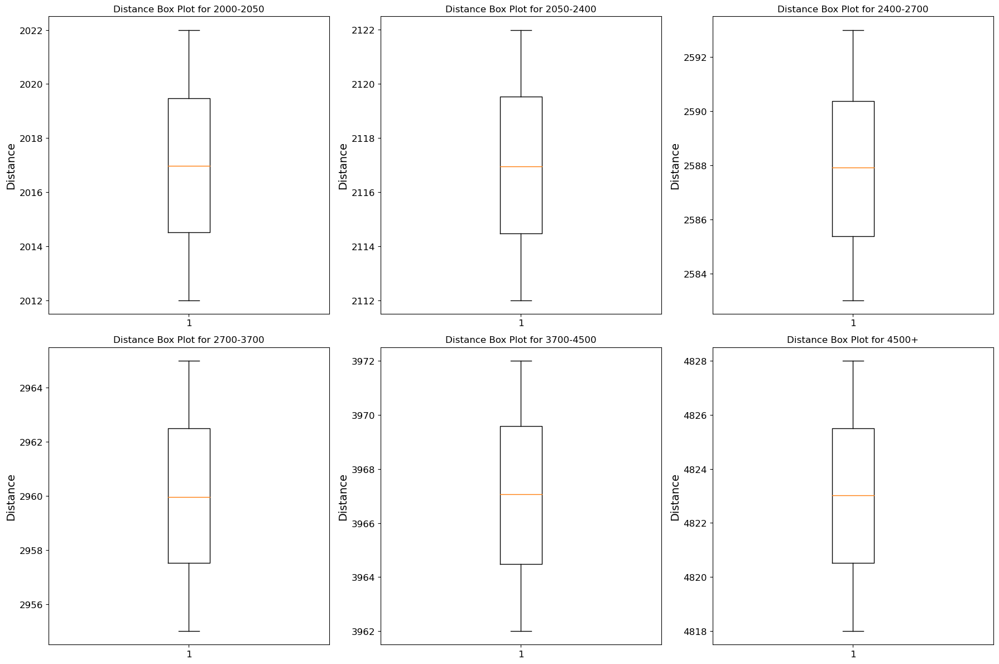

In [12]:
# Define the range breakpoints, including specific sections for outlier ranges
bins = [0, 2050, 2400, 2700, 3700, 4500, data_clean['Distance'].max()]

# Using pd.cut to segment the Distance into bins; these labels represent each segment range
bins_labels = pd.cut(data_clean['Distance'], bins=bins, right=False, labels=["2000-2050", "2050-2400", "2400-2700", "2700-3700", "3700-4500", "4500+"])
distance_segmented = pd.concat([data_clean['Distance'], bins_labels], axis=1, keys=['Distance', 'Range'])

# Create box plots for each segment in a 2x3 grid
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

# Flatten the axs array for easier indexing
axs = axs.flatten()

# Plotting each boxplot
for i, (range_label, group) in enumerate(distance_segmented.groupby('Range')):
    axs[i].boxplot(group['Distance'])
    axs[i].set_title(f'Distance Box Plot for {range_label}')
    axs[i].set_ylabel('Distance')

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

plt.tight_layout()
plt.show()

The box plots are perfect, no outliers any longer. 

Frequency(Column7): The radio frequency (RF) spectrum utilized in this study was tested within the frequency range from 73.5 to 83.5 GHz. The laser frequency was highly concentrated, precisely at 193.4 THz. It should be noticed that the 'frequencicy' from the dataset exclusively pertain to RF. For the purposes of subsequent analyses, the higher RF frequency of 83.5 GHz will be encoded as '1', and the lower frequency of 73.5 GHz be encoded as '0'.

In [13]:
# Define a function to encode frequency
def encode_frequency(freq):
    if freq == 83.5e9:  # Frequency in GHz, converted to Hz for comparison
        return 1
    elif freq == 73.5e9:  # Frequency in GHz, converted to Hz for comparison
        return 0
    else:
        return None  # Handle unexpected frequency values

# Apply the encoding function to the Frequency column
data_clean['Frequency_Encoded'] = data_clean['Frequency'].apply(encode_frequency)

# Replace the original Frequency column with Frequency_Encoded
data_clean['Frequency'] = data_clean['Frequency_Encoded']
del data_clean['Frequency_Encoded']  # Optionally remove the temporary encoded column

# Remove rows with frequencies that do not encode to 0 or 1
data_clean = data_clean[data_clean['Frequency'].notnull()]

In [14]:
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMax,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin
0,7.913289,6.927868,17.595709,17.615907,17.340148,2115.338398,1,0.000000,0.0,0.000000,...,26.60303,24.680849,9.0,65884.518460,72336.362230,65617.543750,88.755450,3.057066,6.863808,3.007939
1,7.451176,4.412096,17.549693,17.572415,17.299439,2113.999257,0,0.000000,0.0,0.000000,...,26.377164,24.313108,9.0,64963.410920,68753.386150,60379.327480,99.790057,2.727910,6.468903,2.537393
2,7.072747,6.268740,17.290230,17.644014,16.037894,2118.689047,1,0.000000,0.0,0.000000,...,27.670822,23.150277,10.0,54794.281070,54821.773820,50850.155960,65.730085,1.674810,2.826916,1.640809
3,6.949288,4.317853,16.820880,17.066776,15.895622,2114.632339,0,0.000000,0.0,0.000000,...,26.5221,23.174815,10.0,50205.641590,52519.927530,45374.510900,88.127497,0.962068,2.780643,0.886951
4,7.361052,6.114514,16.813820,17.953974,15.227225,2116.786055,1,0.000000,0.0,0.000000,...,26.305736,24.864100,10.0,59038.325990,64418.329140,54461.246510,84.167414,1.881007,4.476298,1.874052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178711,9.150012,11.968291,23.283256,24.142871,22.169805,3970.846129,1,0.000000,0.0,0.000000,...,27.257926,26.013205,4.0,13041.847800,13458.340660,12411.852990,91.391749,0.000000,0.027596,0.000000
178712,9.333777,11.538030,23.259618,25.104895,21.005496,3969.230652,0,0.000000,0.0,0.000000,...,28.101044,25.032282,4.0,15959.633590,16232.735440,15345.485230,47.997946,0.075640,0.349551,0.069834
178713,8.873168,11.491891,23.331697,23.996130,22.148649,3968.373512,1,0.000000,0.0,0.000000,...,28.249678,26.205773,4.0,13129.663750,13948.560180,11925.979950,103.963102,0.052282,0.178062,0.049824
178714,9.538886,11.526529,21.241027,21.624932,20.736391,3967.550165,0,29.693160,30.76154,28.497137,...,26.880084,25.031934,5.0,15082.787860,15522.762220,14842.654290,82.090779,0.443520,1.838449,0.413146


SYNOPcode(Column15): 'SYNOP code' refers to a numeric system used to categorize various weather conditions. Each weather state is assigned a specific digit, ranging from 0 to 8. Code '0' denotes clear weather, '3' denotes a dust storm, '4' for fog, '5' for drizzle, '6' for rain, '7' for snow, and '8' corresponds to showers.

Arrange SYNOPcode from smallest to largest and plot bar and line graphs with SYNOPcode in horizontal coordinates and FSO_Att and RFL_Att in vertical coordinates.

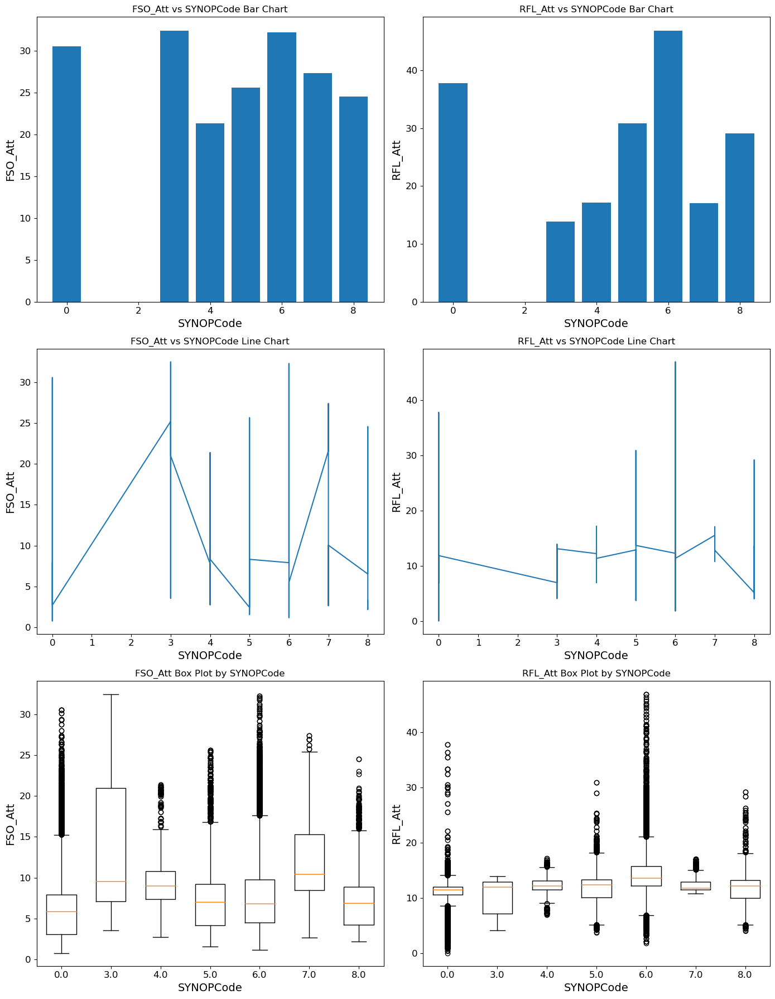

In [15]:
# Step 1: Filter the data to only include SYNOPCode values of 0, 3, 4, 5, 6, 7, 8
valid_synop_codes = [0, 3, 4, 5, 6, 7, 8]
filtered_data = data_clean[data_clean['SYNOPCode'].isin(valid_synop_codes)]

# Step 2: Sort the data by SYNOPCode
sorted_data = filtered_data.sort_values(by='SYNOPCode')

# Step 3: Extract sorted columns for plotting
synop_code = sorted_data['SYNOPCode']
fso_att = sorted_data['FSO_Att']
rfl_att = sorted_data['RFL_Att']

# Step 4: Create a figure and a set of subplots
fig, axs = plt.subplots(3, 2, figsize=(14, 18))

# Plotting Bar Charts
axs[0, 0].bar(synop_code, fso_att)
axs[0, 0].set_title('FSO_Att vs SYNOPCode Bar Chart')
axs[0, 0].set_xlabel('SYNOPCode')
axs[0, 0].set_ylabel('FSO_Att')

axs[0, 1].bar(synop_code, rfl_att)
axs[0, 1].set_title('RFL_Att vs SYNOPCode Bar Chart')
axs[0, 1].set_xlabel('SYNOPCode')
axs[0, 1].set_ylabel('RFL_Att')

# Plotting Line Charts
axs[1, 0].plot(synop_code, fso_att)
axs[1, 0].set_title('FSO_Att vs SYNOPCode Line Chart')
axs[1, 0].set_xlabel('SYNOPCode')
axs[1, 0].set_ylabel('FSO_Att')

axs[1, 1].plot(synop_code, rfl_att)
axs[1, 1].set_title('RFL_Att vs SYNOPCode Line Chart')
axs[1, 1].set_xlabel('SYNOPCode')
axs[1, 1].set_ylabel('RFL_Att')

# Plotting Box Plots for each SYNOPCode
unique_synop_codes = sorted_data['SYNOPCode'].unique()

for idx, synop in enumerate(unique_synop_codes):
    fso_subset = sorted_data[sorted_data['SYNOPCode'] == synop]['FSO_Att']
    rfl_subset = sorted_data[sorted_data['SYNOPCode'] == synop]['RFL_Att']
    
    axs[2, 0].boxplot(fso_subset, positions=[idx], widths=0.6)
    axs[2, 1].boxplot(rfl_subset, positions=[idx], widths=0.6)

axs[2, 0].set_title('FSO_Att Box Plot by SYNOPCode')
axs[2, 0].set_xlabel('SYNOPCode')
axs[2, 0].set_ylabel('FSO_Att')
axs[2, 0].set_xticks(range(len(unique_synop_codes)))
axs[2, 0].set_xticklabels(unique_synop_codes)

axs[2, 1].set_title('RFL_Att Box Plot by SYNOPCode')
axs[2, 1].set_xlabel('SYNOPCode')
axs[2, 1].set_ylabel('RFL_Att')
axs[2, 1].set_xticks(range(len(unique_synop_codes)))
axs[2, 1].set_xticklabels(unique_synop_codes)

# Step 5: Display the plots
plt.tight_layout()
plt.show()


Our data is perfectly classified with SYNOP code 0,3,4,5,6,7,8 with no classification anomalies. However, according to the box plot, our dataset has a lot of outliers, we remove these outliers to reduce the mean square error.

In [16]:
# Step 1: Define a function to remove outliers within each group
def remove_group_outliers(df, column, group_column):
    def remove_outliers(group):
        Q1 = group[column].quantile(0.25)
        Q3 = group[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        return group[(group[column] >= lower_bound) & (group[column] <= upper_bound)]
    
    return df.groupby(group_column).apply(remove_outliers).reset_index(drop=True)

# Step 2: Remove outliers from FSO_Att and RFL_Att for each SYNOPCode group
data_clean_no_outliers = remove_group_outliers(data_clean, 'FSO_Att', 'SYNOPCode')
data_clean_no_outliers = remove_group_outliers(data_clean_no_outliers, 'RFL_Att', 'SYNOPCode')

# Step 3: Filter the cleaned data to only include SYNOPCode values of 0, 3, 4, 5, 6, 7, 8
valid_synop_codes = [0, 3, 4, 5, 6, 7, 8]
data_clean_filtered = data_clean_no_outliers[data_clean_no_outliers['SYNOPCode'].isin(valid_synop_codes)]

# Step 4: Update data_clean with the filtered and cleaned data
data_clean = data_clean_filtered

In [17]:
# Step 5: Display the final cleaned data
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMax,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin
0,7.023193,11.213230,18.998957,20.781501,18.277919,2121.506942,1,0.000000,0.0,0.000000,...,23.648054,21.983483,22.0,36122.93256,36375.51051,33507.44585,86.604932,0.000000,0.000000,0.000000
1,7.405175,10.721190,19.191992,20.499113,18.854686,2115.699724,1,0.000000,0.0,0.000000,...,24.673624,20.817415,23.0,34765.77189,36100.30103,33773.31116,82.713427,0.193848,0.765849,0.174631
2,8.687269,8.680856,18.974710,20.107654,18.480594,2117.875884,1,0.000000,0.0,0.000000,...,24.123722,22.821432,23.0,29768.80920,32682.56163,28830.61642,95.739508,0.327438,1.076152,0.318216
3,7.829537,10.250034,19.283882,19.356842,18.644882,2112.027680,1,0.000000,0.0,0.000000,...,22.921982,21.686898,18.0,32126.73569,32818.50885,29157.45873,102.160795,0.394957,0.897511,0.394236
4,8.128816,8.651911,17.844094,18.250102,17.098698,2117.419742,1,0.000000,0.0,0.000000,...,22.146429,20.136622,23.0,64221.68122,66184.01087,63097.73105,91.973157,2.251684,3.015653,2.094931
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149250,7.754264,12.366070,4.457111,4.845222,4.293367,4822.933611,1,7.133573,7.398327,6.997204,...,1.697396,1.531851,1.0,52520.24563,54258.24259,50738.62403,59.911834,1.667727,2.472327,1.649817
149251,7.873959,12.292626,4.496445,4.559748,4.074900,4822.217167,0,0.000000,0.0,0.000000,...,1.687709,1.461395,1.0,46382.33318,49745.51322,45330.57251,86.947371,0.883154,2.415317,0.799437
149252,7.809871,12.848060,4.496179,4.871242,4.385426,4824.070455,1,7.931666,8.203054,7.857899,...,1.546206,1.458222,1.0,53280.21500,56264.32381,49759.61136,105.229773,1.209350,2.920373,1.187349
149253,7.864476,12.714629,4.572546,4.926224,4.242475,4820.074906,0,8.071216,8.423944,7.835229,...,1.600808,1.482892,1.0,60026.79759,60284.71715,57999.73054,54.783968,1.514047,2.564783,1.390613


Time(Column20): 'time' is defined as the temporal measurement recorded in whole hours(0-24). 

Divide the dataset into 6 cities and then create FSO_Att and RFL_Att bar charts and line charts over time for each of the 6 cities based on the original dataset ordinal number from smallest to largest.

In [18]:
# Define the range breakpoints for "Distance"
bins = [0, 2050, 2400, 2700, 3700, 4500, data_clean['Distance'].max()]

# Segment the Distance into bins and label them
bins_labels = pd.cut(data_clean['Distance'], bins=bins, right=False, labels=["2000-2050", "2050-2400", "2400-2700", "2700-3700", "3700-4500", "4500+"])
data_clean['City'] = bins_labels

# Sort data by "Time" within each city
data_clean = data_clean.sort_values(by=['City', 'Time'])

# Plotting bar and line charts for each city
unique_cities = data_clean['City'].unique()

We start by stacking FSO_Att and RFL_Att from different time periods but the same point in time to see the stack size.

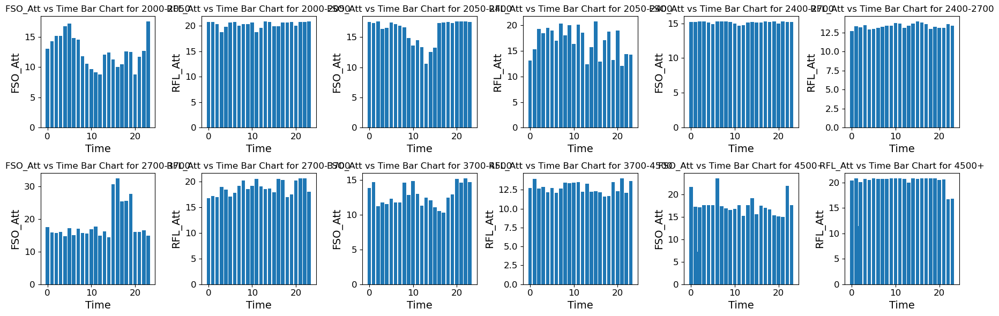

In [19]:
# Number of rows needed
n_rows = int(np.ceil(len(unique_cities) / 6))

# Bar Charts
fig, axs = plt.subplots(n_rows, 6, figsize=(18, 3 * n_rows))

# Flatten the axs array for easier indexing
axs = axs.flatten()

for i, city in enumerate(unique_cities):
    if i >= len(axs) // 2:
        break
    
    city_data = data_clean[data_clean['City'] == city]
    time = city_data['Time']
    fso_att_time = city_data['FSO_Att']
    rfl_att_time = city_data['RFL_Att']

    # Plotting Bar Charts
    axs[i * 2].bar(time, fso_att_time)
    axs[i * 2].set_title(f'FSO_Att vs Time Bar Chart for {city}')
    axs[i * 2].set_xlabel('Time')
    axs[i * 2].set_ylabel('FSO_Att')

    axs[i * 2 + 1].bar(time, rfl_att_time)
    axs[i * 2 + 1].set_title(f'RFL_Att vs Time Bar Chart for {city}')
    axs[i * 2 + 1].set_xlabel('Time')
    axs[i * 2 + 1].set_ylabel('RFL_Att')

# Hide any unused subplots
for j in range(len(unique_cities) * 2, len(axs)):
    fig.delaxes(axs[j])

fig.tight_layout()
plt.show()

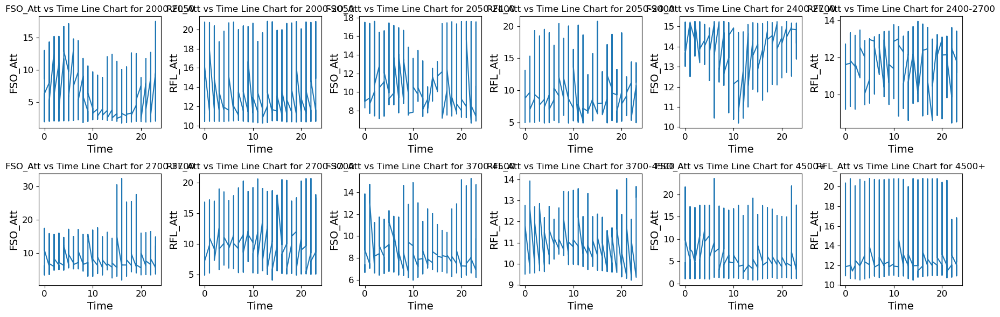

In [20]:
# Number of rows needed
n_rows = int(np.ceil(len(unique_cities) / 6))

# Line Charts
fig, axs = plt.subplots(n_rows, 6, figsize=(18, 3 * n_rows))

# Flatten the axs array for easier indexing
axs = axs.flatten()

for i, city in enumerate(unique_cities):
    if i >= len(axs) // 2:
        break
    
    city_data = data_clean[data_clean['City'] == city]
    time = city_data['Time']
    fso_att_time = city_data['FSO_Att']
    rfl_att_time = city_data['RFL_Att']

    # Plotting Line Charts
    axs[i * 2].plot(time, fso_att_time)
    axs[i * 2].set_title(f'FSO_Att vs Time Line Chart for {city}')
    axs[i * 2].set_xlabel('Time')
    axs[i * 2].set_ylabel('FSO_Att')

    axs[i * 2 + 1].plot(time, rfl_att_time)
    axs[i * 2 + 1].set_title(f'RFL_Att vs Time Line Chart for {city}')
    axs[i * 2 + 1].set_xlabel('Time')
    axs[i * 2 + 1].set_ylabel('RFL_Att')

# Hide any unused subplots
for j in range(len(unique_cities) * 2, len(axs)):
    fig.delaxes(axs[j])

fig.tight_layout()
plt.show()

Then we come to the time series situation of the observations

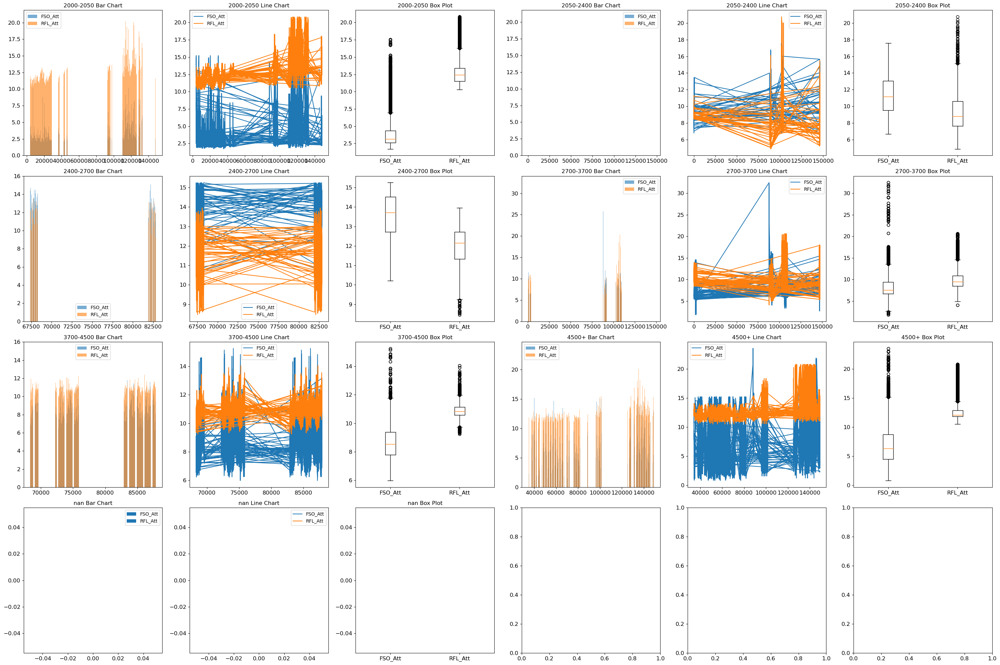

In [21]:
# Function to plot charts for each city
def plot_city_charts(axs, row_idx, col_idx, city_label):
    city_data = data_clean[data_clean['City'] == city_label]
    
    # Bar Plots
    axs[row_idx, col_idx * 3].bar(city_data.index, city_data['FSO_Att'], alpha=0.6, label='FSO_Att')
    axs[row_idx, col_idx * 3].bar(city_data.index, city_data['RFL_Att'], alpha=0.6, label='RFL_Att')
    axs[row_idx, col_idx * 3].set_title(f'{city_label} Bar Chart')
    axs[row_idx, col_idx * 3].legend()
    
    # Line Plots
    axs[row_idx, col_idx * 3 + 1].plot(city_data.index, city_data['FSO_Att'], label='FSO_Att')
    axs[row_idx, col_idx * 3 + 1].plot(city_data.index, city_data['RFL_Att'], label='RFL_Att')
    axs[row_idx, col_idx * 3 + 1].set_title(f'{city_label} Line Chart')
    axs[row_idx, col_idx * 3 + 1].legend()
    
    # Box Plots
    axs[row_idx, col_idx * 3 + 2].boxplot([city_data['FSO_Att'], city_data['RFL_Att']], labels=['FSO_Att', 'RFL_Att'])
    axs[row_idx, col_idx * 3 + 2].set_title(f'{city_label} Box Plot')

# Determine the number of rows needed
n_rows = int(np.ceil(len(unique_cities) / 2))  # 2 cities per row, each city has 3 plots

# Create subplots
fig, axs = plt.subplots(n_rows, 6, figsize=(30, 5 * n_rows))

# Flatten the axs array for easier indexing
axs = axs.reshape(n_rows, -1)

# Plot charts for each unique city range
for i, city_label in enumerate(unique_cities):
    row_idx = i // 2
    col_idx = i % 2
    plot_city_charts(axs, row_idx, col_idx, city_label)

plt.tight_layout()
plt.show()

Delete the relative ordinates that do not correspond to fso_att and rfl_att in the plots corresponding to the classification of the six cities in the code above, to make their data appear more continuous, and remove outliers.

In [22]:
# Define the range breakpoints for "Distance"
bins = [0, 2050, 2400, 2700, 3700, 4500, data['Distance'].max()]

# Segment the Distance into bins and label them
bins_labels = pd.cut(data['Distance'], bins=bins, right=False, labels=["2000-2050", "2050-2400", "2400-2700", "2700-3700", "3700-4500", "4500+"])
data['City'] = bins_labels

# Sort data by "Time" within each city
data = data.sort_values(by=['City', 'Time'])

# Get unique city labels
unique_cities = data['City'].unique()

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices = set()

def plot_city_charts(axs, row_idx, col_idx, city_label, original_data):
    city_data = original_data[original_data['City'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, ['FSO_Att', 'RFL_Att'])
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing FSO_Att or RFL_Att
    city_data = city_data.dropna(subset=['FSO_Att', 'RFL_Att'])

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    # Plot bar charts
    axs[row_idx, col_idx * 3].bar(city_data.index, city_data['FSO_Att'], alpha=0.6, label='FSO_Att')
    axs[row_idx, col_idx * 3].bar(city_data.index, city_data['RFL_Att'], alpha=0.6, label='RFL_Att')
    axs[row_idx, col_idx * 3].set_title(f'{city_label} Bar Chart')
    axs[row_idx, col_idx * 3].legend()
    
    # Plot line charts
    axs[row_idx, col_idx * 3 + 1].plot(city_data.index, city_data['FSO_Att'], label='FSO_Att')
    axs[row_idx, col_idx * 3 + 1].plot(city_data.index, city_data['RFL_Att'], label='RFL_Att')
    axs[row_idx, col_idx * 3 + 1].set_title(f'{city_label} Line Chart')
    axs[row_idx, col_idx * 3 + 1].legend()
    
    # Plot box plots
    axs[row_idx, col_idx * 3 + 2].boxplot([city_data['FSO_Att'], city_data['RFL_Att']], labels=['FSO_Att', 'RFL_Att'])
    axs[row_idx, col_idx * 3 + 2].set_title(f'{city_label} Box Plot')

    return city_data

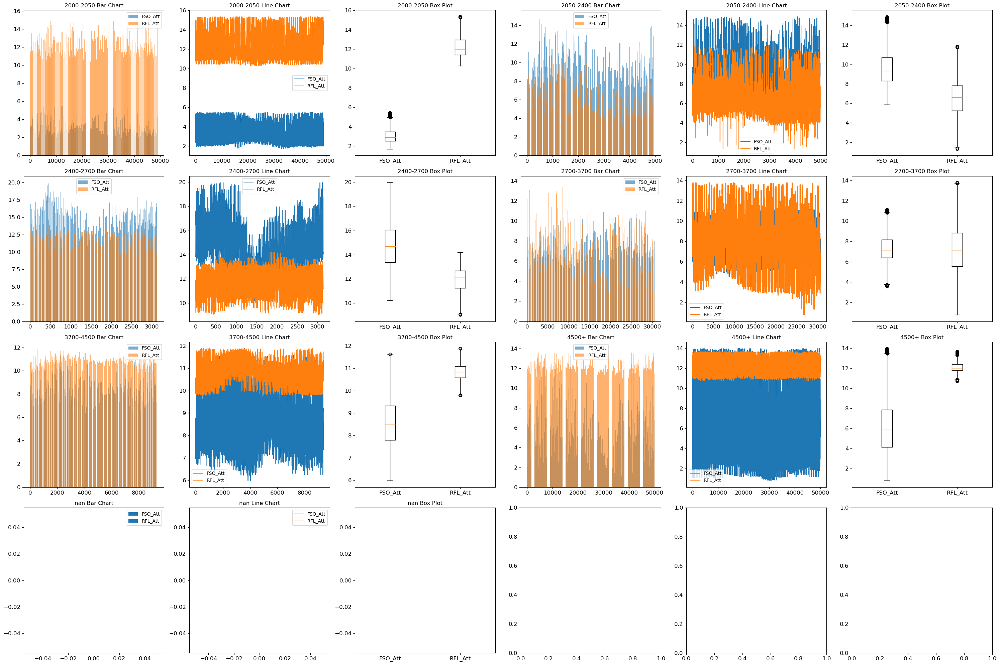

In [23]:
# Determine the number of rows needed
n_rows = int(np.ceil(len(unique_cities) / 2))  # 2 cities per row, each city has 3 plots

# Create subplots
fig, axs = plt.subplots(n_rows, 6, figsize=(30, 5 * n_rows))

# Plot charts for each unique city range
cleaned_data = pd.DataFrame()
for i, city_label in enumerate(unique_cities):
    row_idx = i // 2
    col_idx = i % 2
    cleaned_city_data = plot_city_charts(axs, row_idx, col_idx, city_label, data)
    cleaned_data = pd.concat([cleaned_data, cleaned_city_data])

plt.tight_layout()
plt.show()

After processing the dataset, we can clearly observe the regular fluctuations of FSO_Att and RFL_Att based on the time series.

In [24]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [25]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City
3789,8.627118,11.304555,5.299959,5.742355,4.974912,2018.295810,0,0.000000,0.0,0.000000,...,4.137833,0.0,12724.656010,13701.343940,12629.120490,174.995511,0.838424,0.981762,0.764520,2000-2050
3790,10.704295,11.574301,5.220256,5.664049,4.818425,2016.798357,1,0.000000,0.0,0.000000,...,3.286935,0.0,12220.828460,12912.932870,11656.486300,95.521578,0.953865,1.238873,0.917399,2000-2050
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.0,0.000000,...,3.268077,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.0,0.000000,...,3.552237,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.0,0.000000,...,1.936630,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149220,7.213765,13.438541,5.298393,5.686192,5.043420,4818.601809,1,39.675308,42.241977,37.073837,...,5.094957,23.0,24742.325070,25734.816480,22414.247500,114.689897,2.381475,7.730204,2.358540,4500+
149221,6.603556,13.830876,5.260379,5.420117,4.776382,4823.642139,0,26.808287,29.448781,24.466794,...,5.163649,23.0,27941.209470,29846.979860,27319.210560,87.919266,0.634898,3.620630,0.600779,4500+
149222,7.281867,12.038734,5.314213,5.755513,4.984886,4826.415192,1,36.542449,39.397911,36.030000,...,4.837640,23.0,20465.916520,22466.788810,19945.536390,90.811829,0.435202,7.106312,0.396422,4500+
149223,5.450632,12.375695,5.280926,5.657310,4.835138,4824.572169,0,0.000000,0.0,0.000000,...,4.983196,23.0,68699.770370,71757.764180,65082.321780,97.336133,2.054689,4.819188,1.990214,4500+


#### 2.3 continuous variables

Absolute Humidity Average/Max/Min (Columns 3-5): AbsoluteHumidityAve/AbsoluteHumidityMax/AbsoluteHumidityMin are defined as the mean/max/min absolute humidity over the specified time period. The variables were divided into datasets corresponding to the six cities based on distance, and bar, line and box plots were plotted for the three variables.

In [26]:
# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices = set()

def plot_city_charts(axs, row_idx, col_idx, city_label, original_data, columns):
    city_data = original_data[original_data['City'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    # Plot bar charts
    for column in columns:
        axs[row_idx, col_idx * 3].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[row_idx, col_idx * 3].set_title(f'{city_label} Bar Chart')
    axs[row_idx, col_idx * 3].legend()
    
    # Plot line charts
    for column in columns:
        axs[row_idx, col_idx * 3 + 1].plot(city_data.index, city_data[column], label=column)
    axs[row_idx, col_idx * 3 + 1].set_title(f'{city_label} Line Chart')
    axs[row_idx, col_idx * 3 + 1].legend()
    
    # Plot box plots
    axs[row_idx, col_idx * 3 + 2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[row_idx, col_idx * 3 + 2].set_title(f'{city_label} Box Plot')

    return city_data

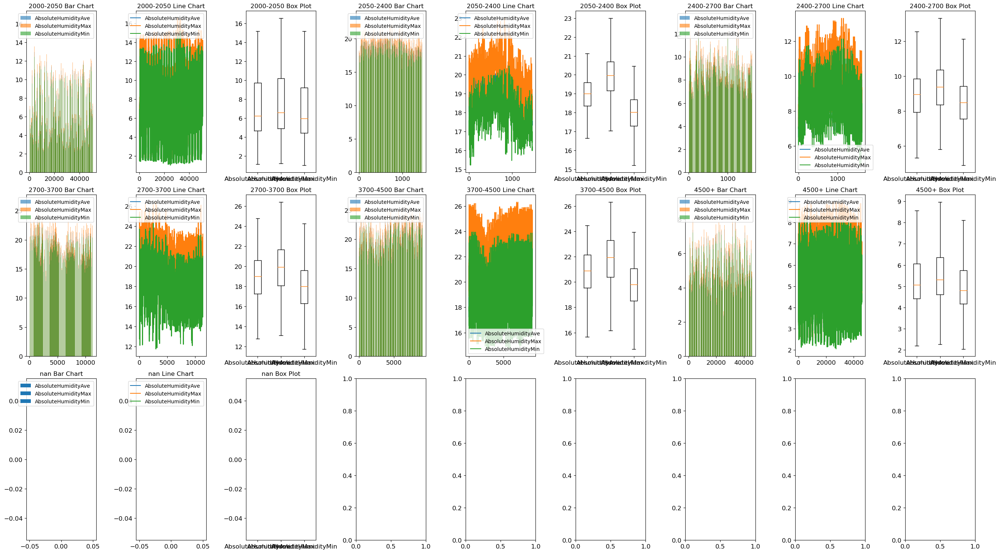

In [27]:
# Define the columns to process
humidity_columns = ['AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin']

# Determine the number of rows needed
n_rows = int(np.ceil(len(unique_cities) / 3))  # 3 cities per row, each city has 3 plots

# Create subplots
fig, axs = plt.subplots(n_rows, 9, figsize=(27, 5 * n_rows))

# Plot charts for each unique city range
cleaned_humidity_data = pd.DataFrame()
for i, city_label in enumerate(unique_cities):
    row_idx = i // 3
    col_idx = i % 3
    cleaned_city_data = plot_city_charts(axs, row_idx, col_idx, city_label, data_clean, humidity_columns)
    cleaned_humidity_data = pd.concat([cleaned_humidity_data, cleaned_city_data])

plt.tight_layout()
plt.show()

In [28]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [29]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City
3789,8.627118,11.304555,5.299959,5.742355,4.974912,2018.295810,0,0.000000,0.0,0.000000,...,4.137833,0.0,12724.656010,13701.343940,12629.120490,174.995511,0.838424,0.981762,0.764520,2000-2050
3790,10.704295,11.574301,5.220256,5.664049,4.818425,2016.798357,1,0.000000,0.0,0.000000,...,3.286935,0.0,12220.828460,12912.932870,11656.486300,95.521578,0.953865,1.238873,0.917399,2000-2050
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.0,0.000000,...,3.268077,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.0,0.000000,...,3.552237,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.0,0.000000,...,1.936630,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149220,7.213765,13.438541,5.298393,5.686192,5.043420,4818.601809,1,39.675308,42.241977,37.073837,...,5.094957,23.0,24742.325070,25734.816480,22414.247500,114.689897,2.381475,7.730204,2.358540,4500+
149221,6.603556,13.830876,5.260379,5.420117,4.776382,4823.642139,0,26.808287,29.448781,24.466794,...,5.163649,23.0,27941.209470,29846.979860,27319.210560,87.919266,0.634898,3.620630,0.600779,4500+
149222,7.281867,12.038734,5.314213,5.755513,4.984886,4826.415192,1,36.542449,39.397911,36.030000,...,4.837640,23.0,20465.916520,22466.788810,19945.536390,90.811829,0.435202,7.106312,0.396422,4500+
149223,5.450632,12.375695,5.280926,5.657310,4.835138,4824.572169,0,0.000000,0.0,0.000000,...,4.983196,23.0,68699.770370,71757.764180,65082.321780,97.336133,2.054689,4.819188,1.990214,4500+


Particulate/Max/Min(Column8-10): 'Particulate' refers to the concentration of particulate matter in the air. 'ParticulateMax/Min' denotes the maximum/minimum concentration of particulate matter recorded during the observation period.

In [30]:
# Ensure columns are numeric
data_clean['Particulate'] = pd.to_numeric(data_clean['Particulate'], errors='coerce')
data_clean['ParticulateMax'] = pd.to_numeric(data_clean['ParticulateMax'], errors='coerce')
data_clean['ParticulateMin'] = pd.to_numeric(data_clean['ParticulateMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['City'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    # Create a figure and subplots
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

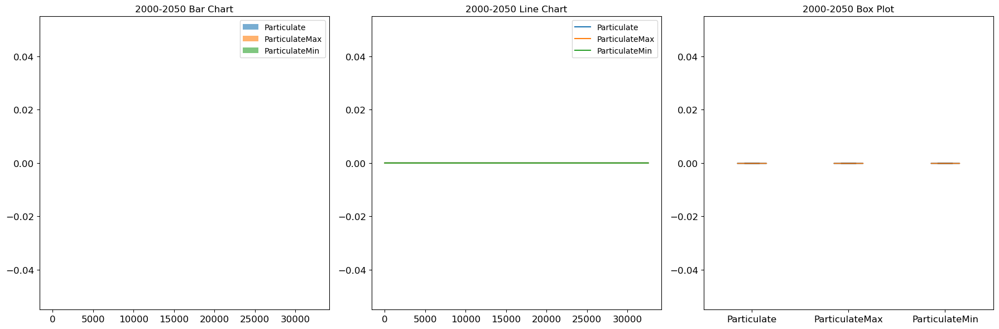

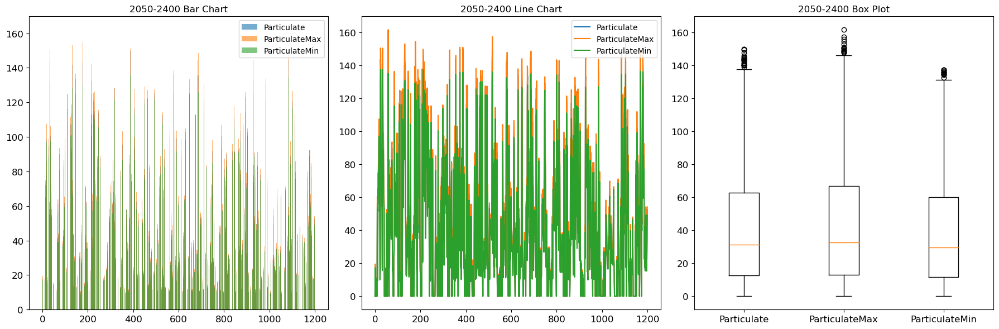

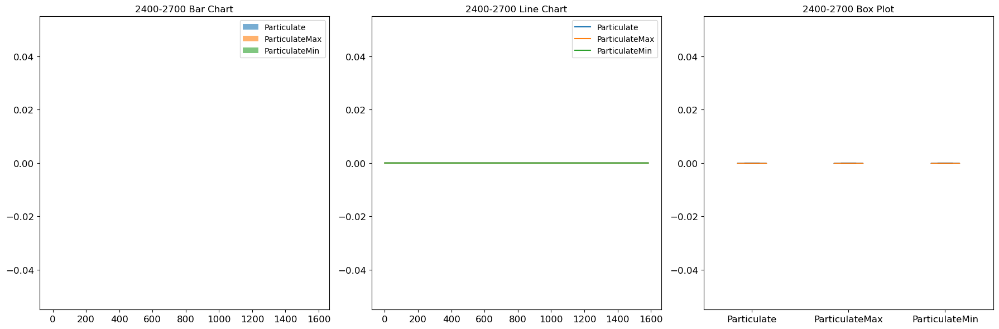

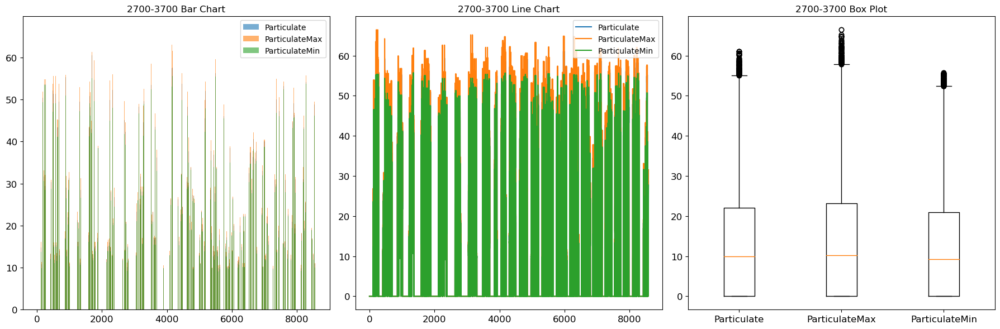

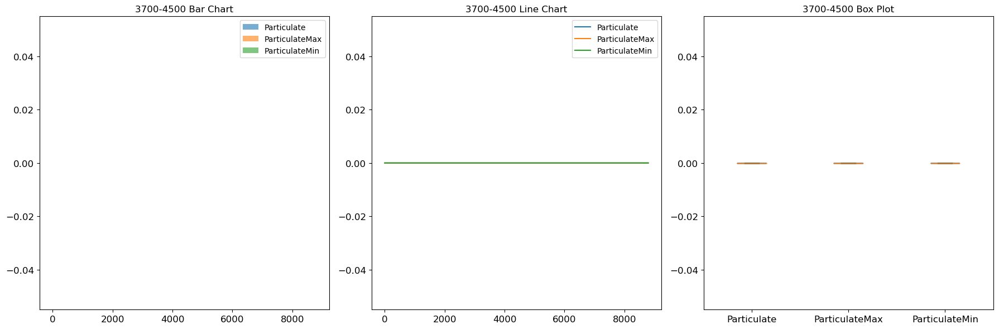

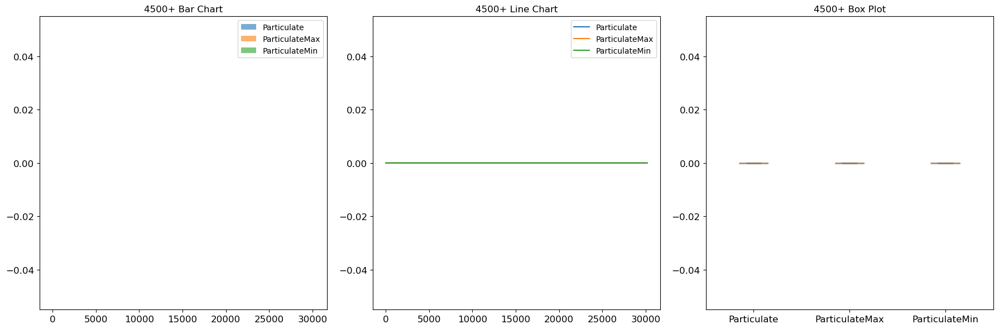

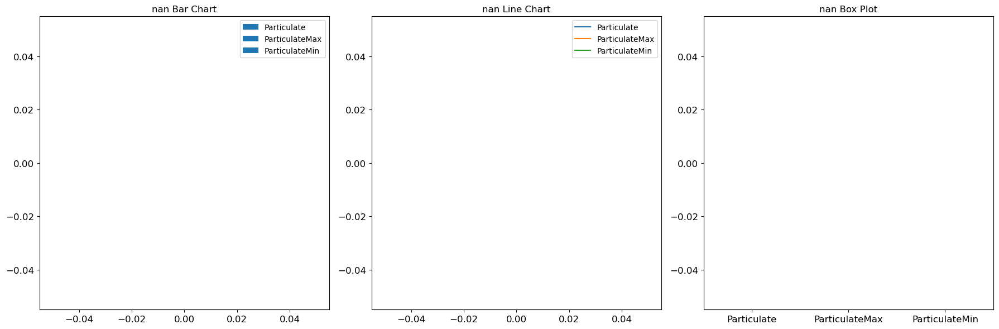

Total cleaned data size: 82936


In [31]:
# Define the columns to process
particulate_columns = ['Particulate', 'ParticulateMax', 'ParticulateMin']

# Plot charts for each unique city range
cleaned_particulate_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, particulate_columns)
    if not cleaned_city_data.empty:
        cleaned_particulate_data = pd.concat([cleaned_particulate_data, cleaned_city_data])

print(f"Total cleaned data size: {len(cleaned_particulate_data)}")

There is also a clear division of particulate matter concentrations based on city. The fact that some cities have zero data for the particulate matter concentration indicator is further evidence of the need for a city-based classification.

The data cleaning described above pre-modelled an excessive number of outliers, many of which belonged to row 0 in the original dataset, which clearly needed to be modified. Obviously there are a lot of 0 rows in our dataset, but they are not really outliers and these values need to be retained, so we need to delete the outliers and keep the 0 rows.

In [32]:
# Ensure columns are numeric
data_clean['Particulate'] = pd.to_numeric(data_clean['Particulate'], errors='coerce')
data_clean['ParticulateMax'] = pd.to_numeric(data_clean['ParticulateMax'], errors='coerce')
data_clean['ParticulateMin'] = pd.to_numeric(data_clean['ParticulateMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['City'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively for specific ranges
    if city_label in ["2050-2400", "2700-3700"]:
        for _ in range(2):  # Increase iterations if necessary
            city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    # Create a figure and subplots
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

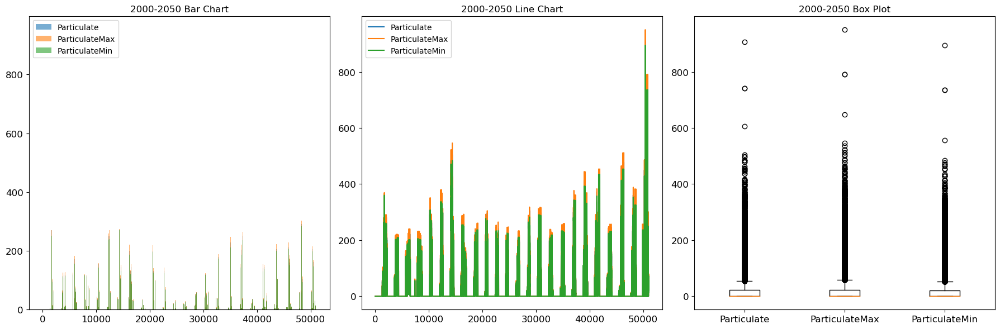

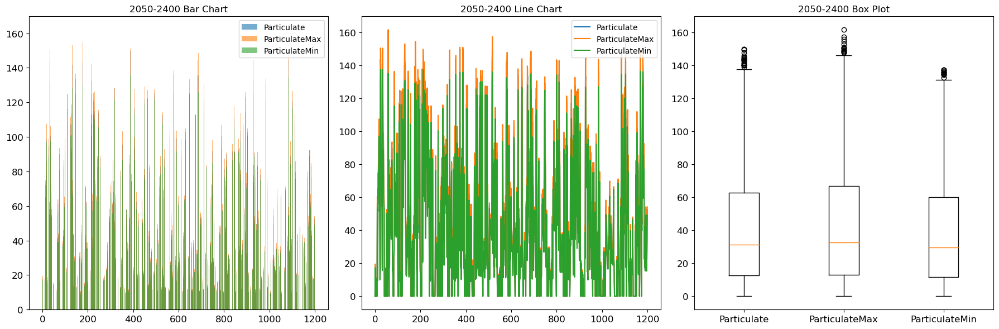

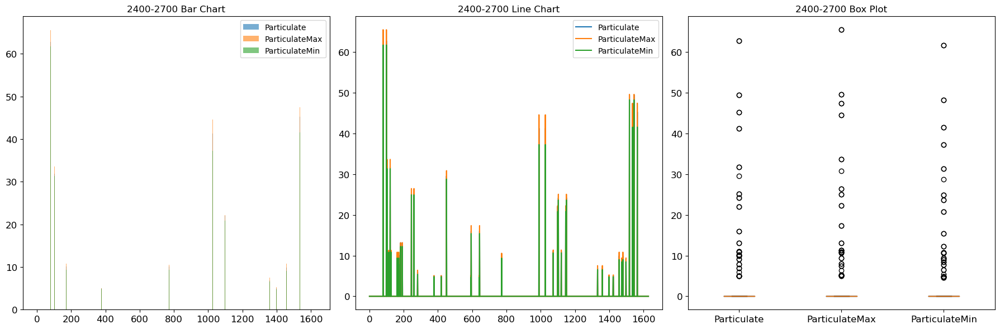

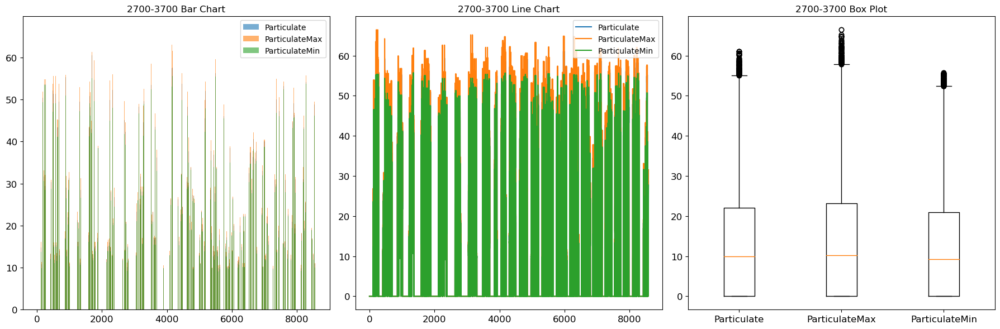

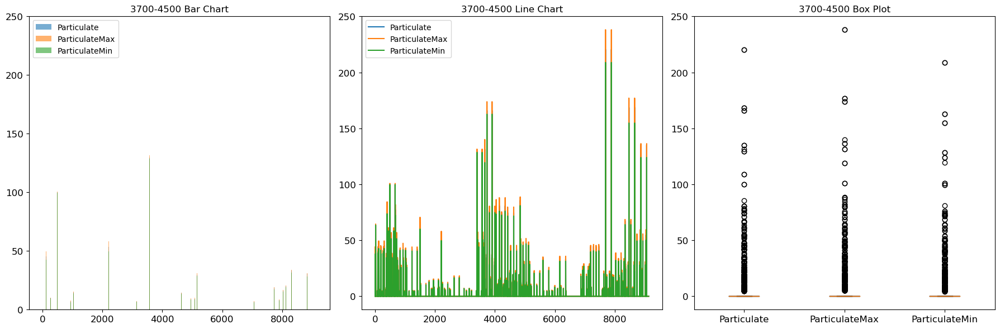

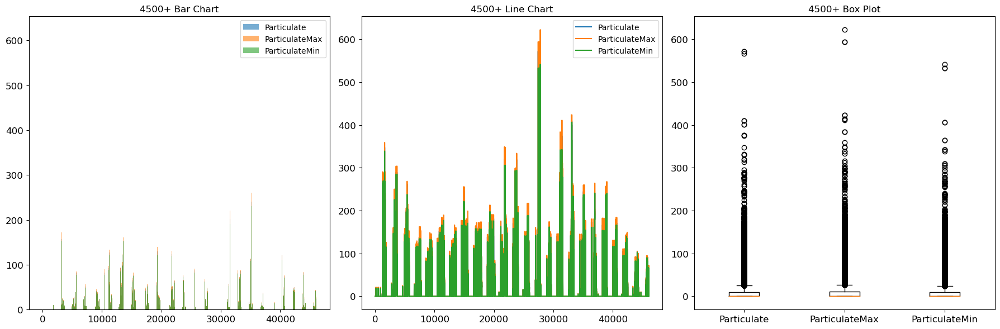

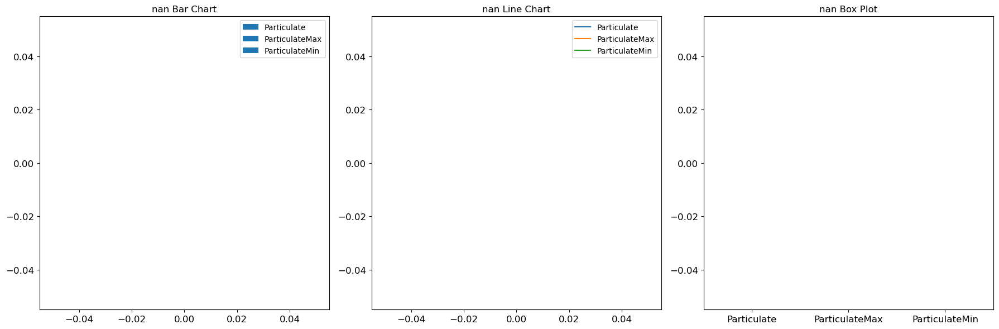

Total cleaned data size: 117569


In [33]:
# Define the columns to process
particulate_columns = ['Particulate', 'ParticulateMax', 'ParticulateMin']

# Plot charts for each unique city range
cleaned_particulate_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, particulate_columns)
    if not cleaned_city_data.empty:
        cleaned_particulate_data = pd.concat([cleaned_particulate_data, cleaned_city_data])

print(f"Total cleaned data size: {len(cleaned_particulate_data)}")

In [34]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,TemperatureMin,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City
3789,8.627118,11.304555,5.299959,5.742355,4.974912,2018.295810,0,0.000000,0.000000,0.000000,...,4.137833,0.0,12724.656010,13701.343940,12629.120490,174.995511,0.838424,0.981762,0.764520,2000-2050
3790,10.704295,11.574301,5.220256,5.664049,4.818425,2016.798357,1,0.000000,0.000000,0.000000,...,3.286935,0.0,12220.828460,12912.932870,11656.486300,95.521578,0.953865,1.238873,0.917399,2000-2050
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,3.268077,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,3.552237,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.000000,0.000000,...,1.936630,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149220,7.213765,13.438541,5.298393,5.686192,5.043420,4818.601809,1,39.675308,42.241977,37.073837,...,5.094957,23.0,24742.325070,25734.816480,22414.247500,114.689897,2.381475,7.730204,2.358540,4500+
149221,6.603556,13.830876,5.260379,5.420117,4.776382,4823.642139,0,26.808287,29.448781,24.466794,...,5.163649,23.0,27941.209470,29846.979860,27319.210560,87.919266,0.634898,3.620630,0.600779,4500+
149222,7.281867,12.038734,5.314213,5.755513,4.984886,4826.415192,1,36.542449,39.397911,36.030000,...,4.837640,23.0,20465.916520,22466.788810,19945.536390,90.811829,0.435202,7.106312,0.396422,4500+
149223,5.450632,12.375695,5.280926,5.657310,4.835138,4824.572169,0,0.000000,0.000000,0.000000,...,4.983196,23.0,68699.770370,71757.764180,65082.321780,97.336133,2.054689,4.819188,1.990214,4500+


RainIntensity/Max/Min(Column11-13): 'RainIntensity' is defined as the rate of rainfall measured during a specific period. 'RainIntensityMax/Min' represents the peak/lowest rainfall rate recorded.

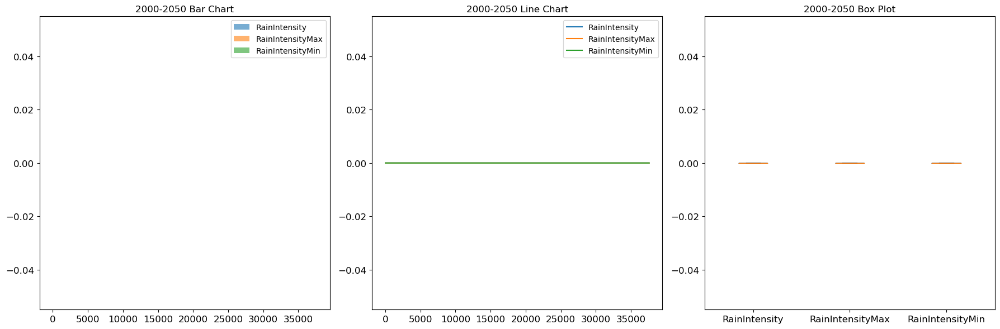

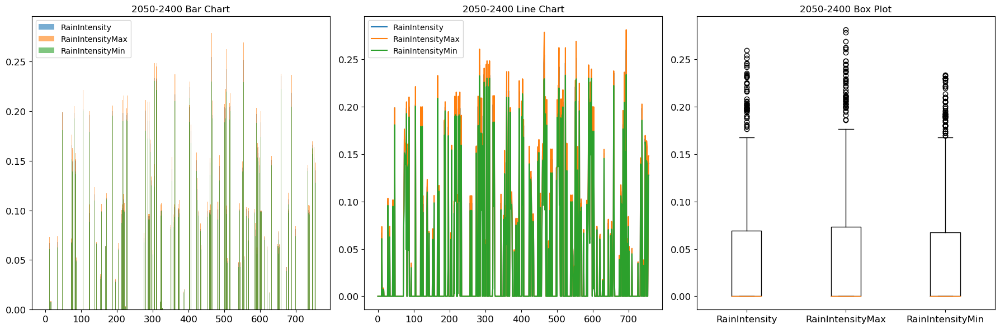

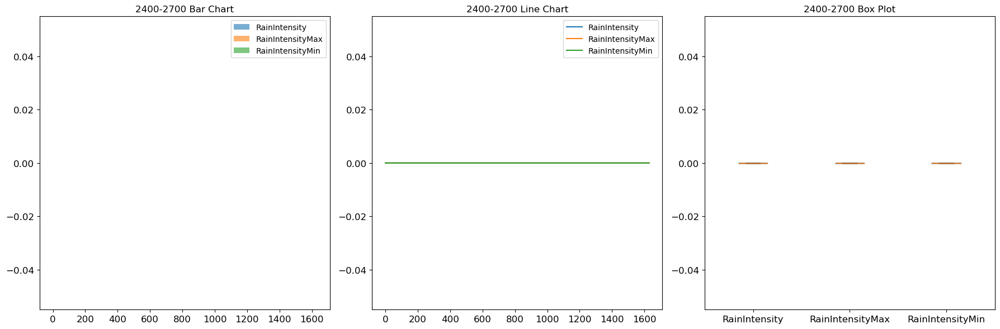

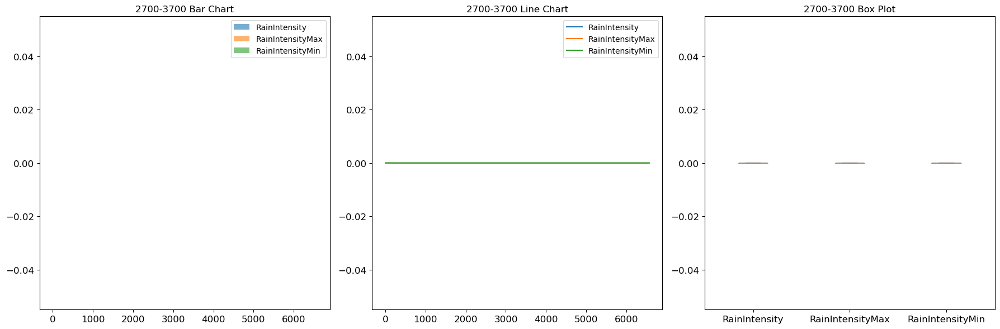

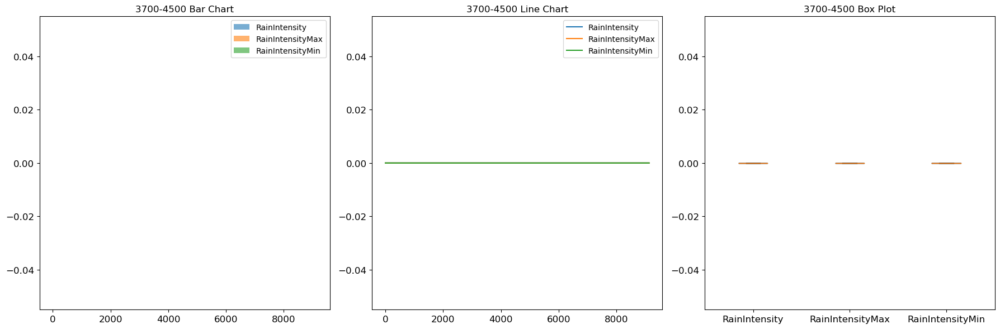

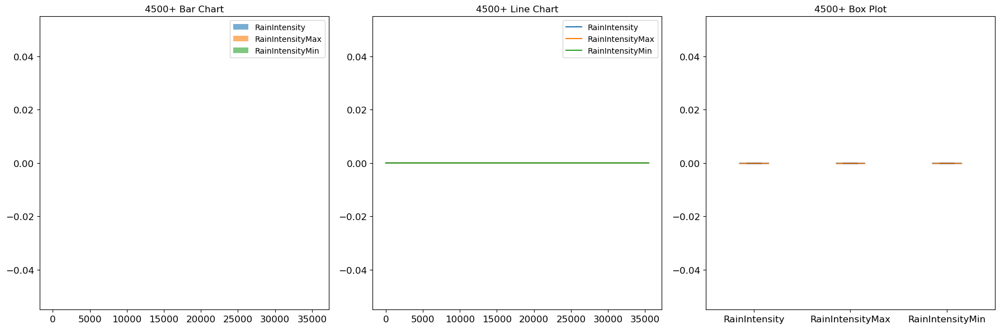

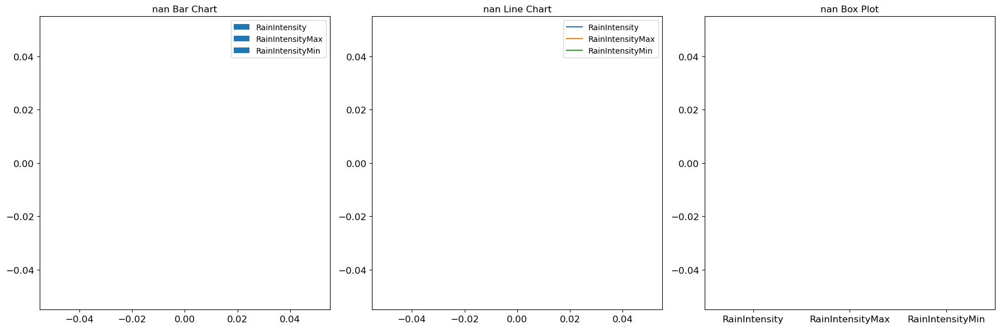

In [36]:
# Ensure columns are numeric
data_clean['RainIntensity'] = pd.to_numeric(data_clean['RainIntensity'], errors='coerce')
data_clean['RainIntensityMax'] = pd.to_numeric(data_clean['RainIntensityMax'], errors='coerce')
data_clean['RainIntensityMin'] = pd.to_numeric(data_clean['RainIntensityMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_rain = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['City'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_rain.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the columns to process
rain_columns = ['RainIntensity', 'RainIntensityMax', 'RainIntensityMin']

# Clean data and plot charts for rain intensity variables
cleaned_rain_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, rain_columns)
    cleaned_rain_data = pd.concat([cleaned_rain_data, cleaned_city_data])

In [37]:
# Add the 'Range' column
bins = [0, 2050, 2400, 2700, 3700, 4500, data_clean['Distance'].max()]
bins_labels = pd.cut(data_clean['Distance'], bins=bins, right=False, labels=["2000-2050", "2050-2400", "2400-2700", "2700-3700", "3700-4500", "4500+"])
data_clean['Range'] = bins_labels

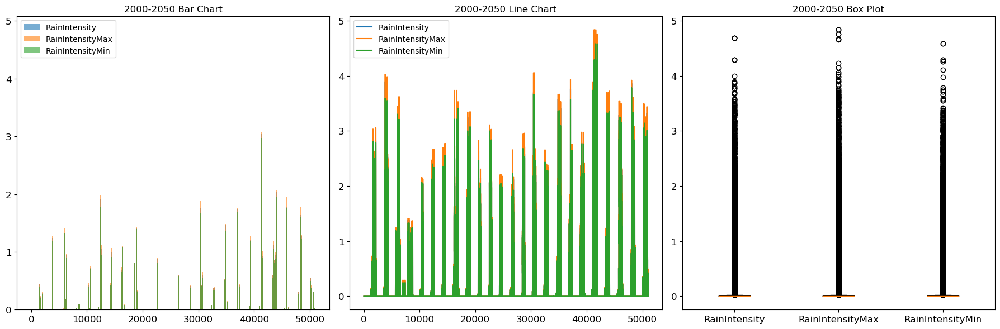

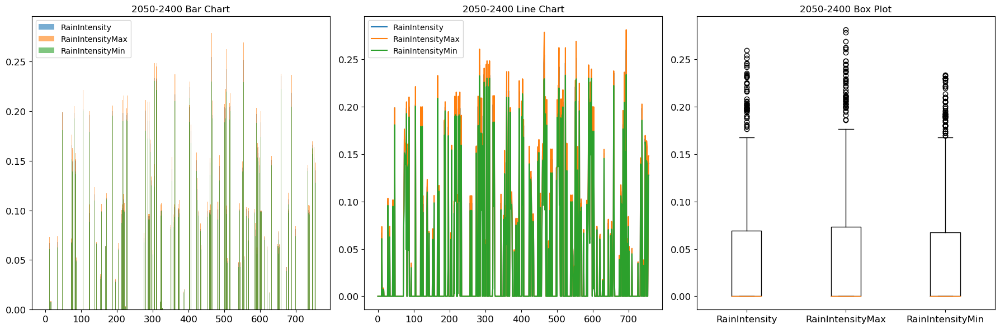

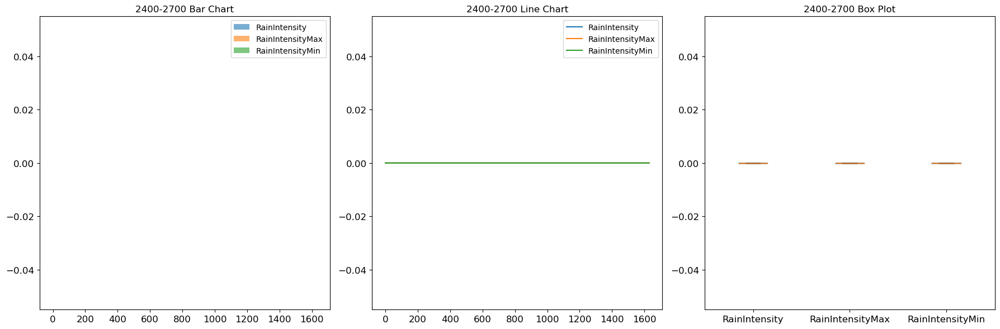

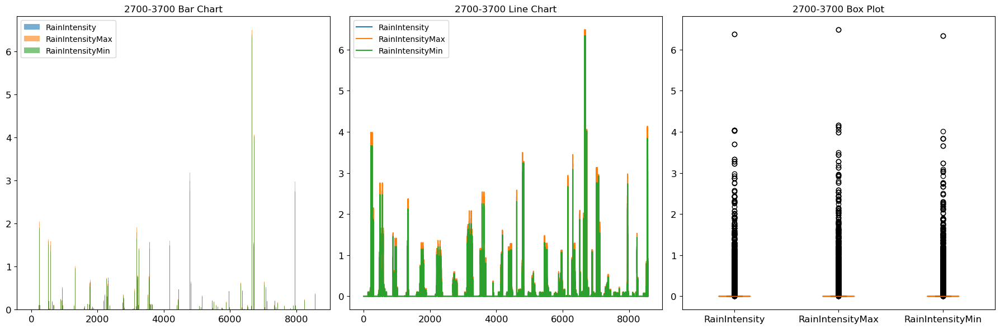

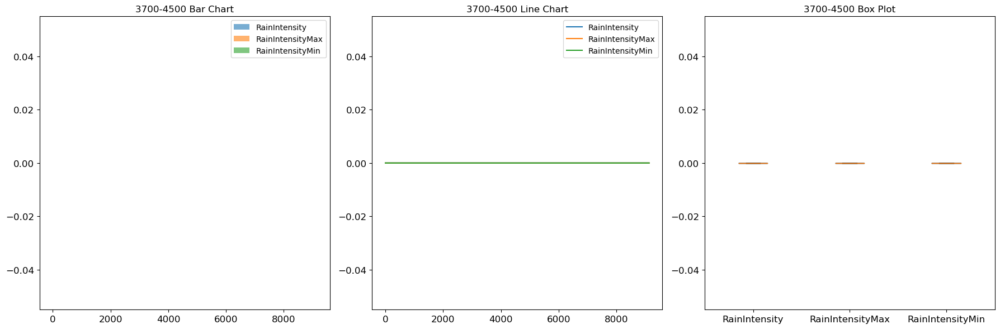

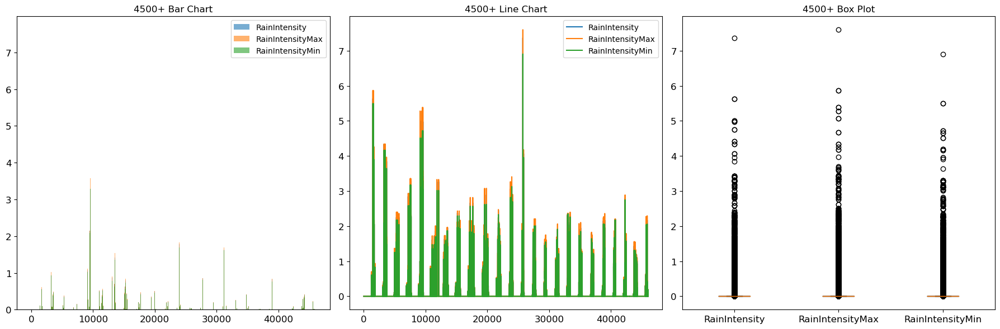

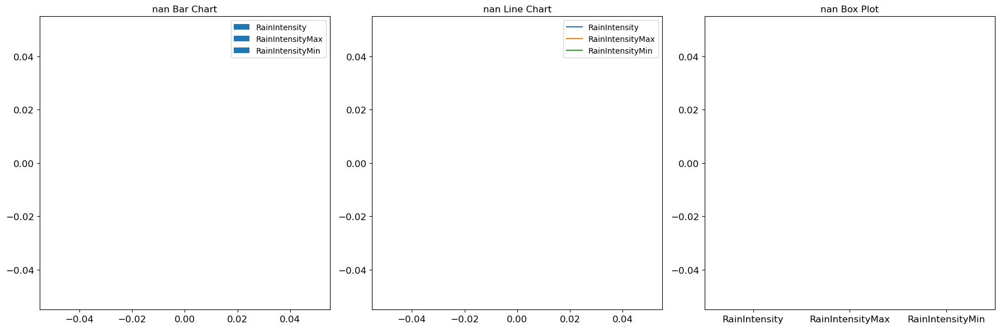

In [38]:
# Ensure columns are numeric
data_clean['RainIntensity'] = pd.to_numeric(data_clean['RainIntensity'], errors='coerce')
data_clean['RainIntensityMax'] = pd.to_numeric(data_clean['RainIntensityMax'], errors='coerce')
data_clean['RainIntensityMin'] = pd.to_numeric(data_clean['RainIntensityMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_rain = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['Range'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively for specific ranges
    if city_label == "2050-2400":
        for _ in range(2):  # Increase iterations if necessary
            city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_rain.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the columns to process
rain_columns = ['RainIntensity', 'RainIntensityMax', 'RainIntensityMin']

# Clean data and plot charts for rain intensity variables
cleaned_rain_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, rain_columns)
    cleaned_rain_data = pd.concat([cleaned_rain_data, cleaned_city_data])

In [39]:
# Remove the collected indices from data_clean
valid_deleted_indices_rain = [index for index in deleted_indices_rain if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices_rain)

In [40]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City,Range
3789,8.627118,11.304555,5.299959,5.742355,4.974912,2018.295810,0,0.000000,0.000000,0.000000,...,0.0,12724.656010,13701.343940,12629.120490,174.995511,0.838424,0.981762,0.764520,2000-2050,2000-2050
3790,10.704295,11.574301,5.220256,5.664049,4.818425,2016.798357,1,0.000000,0.000000,0.000000,...,0.0,12220.828460,12912.932870,11656.486300,95.521578,0.953865,1.238873,0.917399,2000-2050,2000-2050
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.000000,0.000000,...,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149220,7.213765,13.438541,5.298393,5.686192,5.043420,4818.601809,1,39.675308,42.241977,37.073837,...,23.0,24742.325070,25734.816480,22414.247500,114.689897,2.381475,7.730204,2.358540,4500+,4500+
149221,6.603556,13.830876,5.260379,5.420117,4.776382,4823.642139,0,26.808287,29.448781,24.466794,...,23.0,27941.209470,29846.979860,27319.210560,87.919266,0.634898,3.620630,0.600779,4500+,4500+
149222,7.281867,12.038734,5.314213,5.755513,4.984886,4826.415192,1,36.542449,39.397911,36.030000,...,23.0,20465.916520,22466.788810,19945.536390,90.811829,0.435202,7.106312,0.396422,4500+,4500+
149223,5.450632,12.375695,5.280926,5.657310,4.835138,4824.572169,0,0.000000,0.000000,0.000000,...,23.0,68699.770370,71757.764180,65082.321780,97.336133,2.054689,4.819188,1.990214,4500+,4500+


RelativeHumidity(Column14): 'Relative Humidity' is defined as the amount of moisture in the air, expressed as a percentage of the maximum moisture that air can hold at a particular temperature. This variable was measured within a range from 1 to 100.

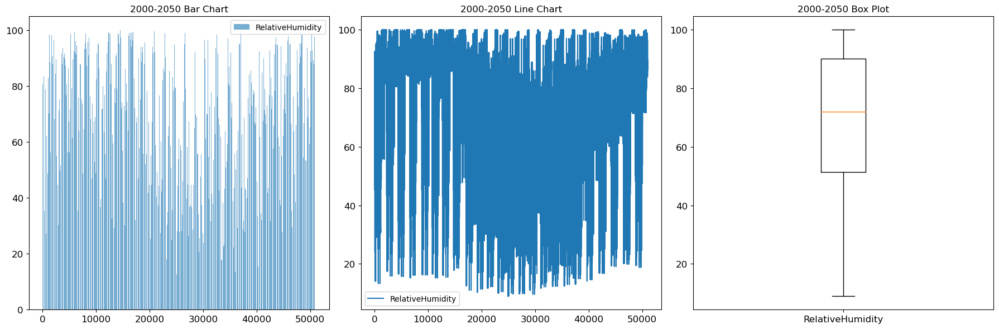

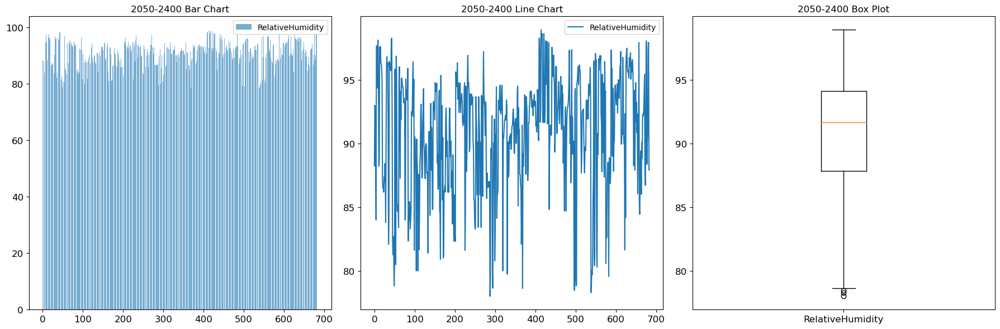

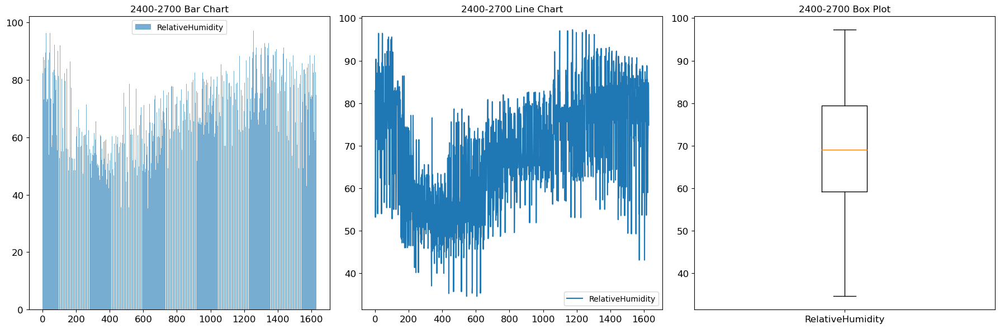

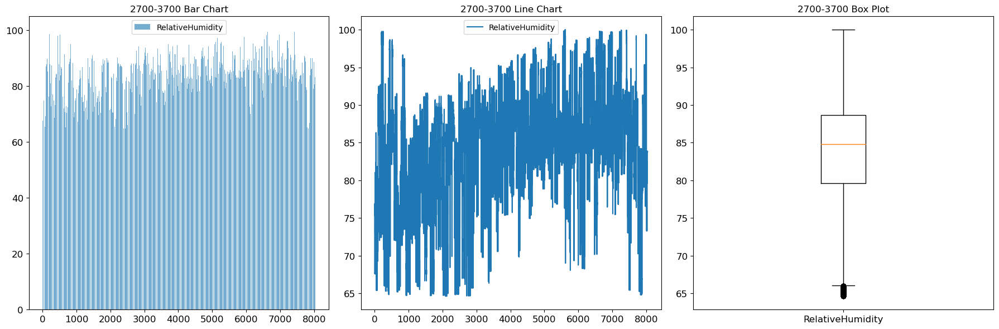

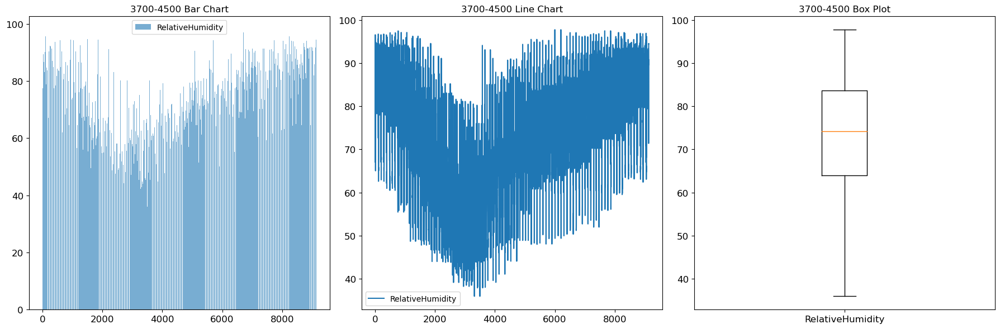

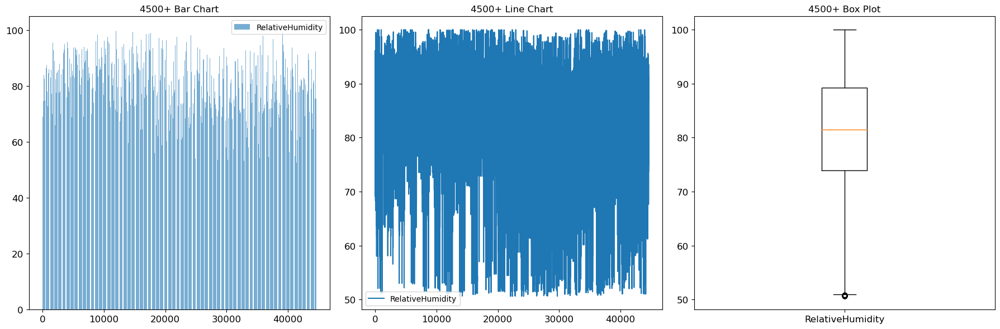

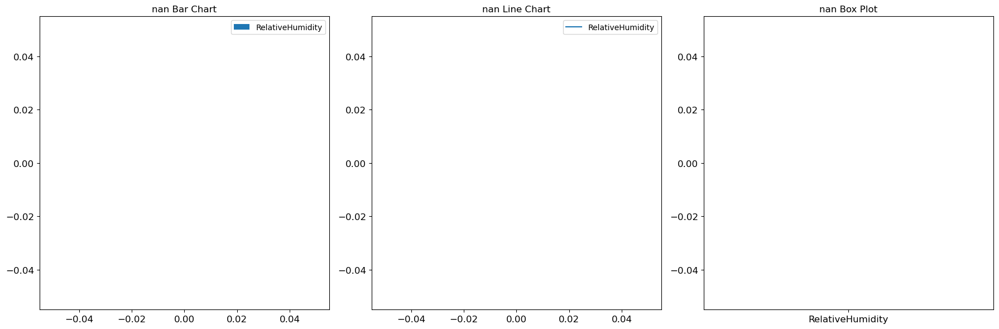

In [41]:
# Ensure columns are numeric
data_clean['RelativeHumidity'] = pd.to_numeric(data_clean['RelativeHumidity'], errors='coerce')

# Function to remove outliers using IQR, considering the specific range for RelativeHumidity
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = max(1, Q1 - 1.5 * IQR)  # Ensuring the lower bound is within the range 1 to 100
    upper_bound = min(100, Q3 + 1.5 * IQR)  # Ensuring the upper bound is within the range 1 to 100
    df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_humidity = set()

def plot_city_charts(city_label, original_data, column):
    city_data = original_data[original_data['Range'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, column)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_humidity.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified column
    city_data = city_data.dropna(subset=[column])

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot(city_data[column], labels=[column])
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the column to process
humidity_column = 'RelativeHumidity'

# Clean data and plot charts for relative humidity variable
cleaned_humidity_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, humidity_column)
    cleaned_humidity_data = pd.concat([cleaned_humidity_data, cleaned_city_data])

In [42]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices_humidity if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [43]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City,Range
3789,8.627118,11.304555,5.299959,5.742355,4.974912,2018.295810,0,0.000000,0.000000,0.000000,...,0.0,12724.656010,13701.343940,12629.120490,174.995511,0.838424,0.981762,0.764520,2000-2050,2000-2050
3790,10.704295,11.574301,5.220256,5.664049,4.818425,2016.798357,1,0.000000,0.000000,0.000000,...,0.0,12220.828460,12912.932870,11656.486300,95.521578,0.953865,1.238873,0.917399,2000-2050,2000-2050
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.000000,0.000000,...,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149220,7.213765,13.438541,5.298393,5.686192,5.043420,4818.601809,1,39.675308,42.241977,37.073837,...,23.0,24742.325070,25734.816480,22414.247500,114.689897,2.381475,7.730204,2.358540,4500+,4500+
149221,6.603556,13.830876,5.260379,5.420117,4.776382,4823.642139,0,26.808287,29.448781,24.466794,...,23.0,27941.209470,29846.979860,27319.210560,87.919266,0.634898,3.620630,0.600779,4500+,4500+
149222,7.281867,12.038734,5.314213,5.755513,4.984886,4826.415192,1,36.542449,39.397911,36.030000,...,23.0,20465.916520,22466.788810,19945.536390,90.811829,0.435202,7.106312,0.396422,4500+,4500+
149223,5.450632,12.375695,5.280926,5.657310,4.835138,4824.572169,0,0.000000,0.000000,0.000000,...,23.0,68699.770370,71757.764180,65082.321780,97.336133,2.054689,4.819188,1.990214,4500+,4500+


Temperature/TemperatureDifference/Max/Min(Column16-19): 'Temperature' refers to the ambient air temperature measured in degrees Celsius. 'TemperatureDifference' represents the variation between the maximum and minimum temperatures recorded during a specific period. 'TemperatureMax/Min' is defined as the highest/lowest temperature recorded during the observation period. 

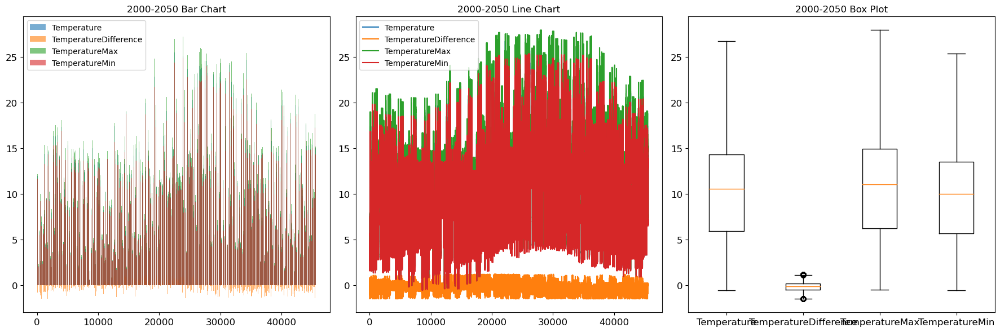

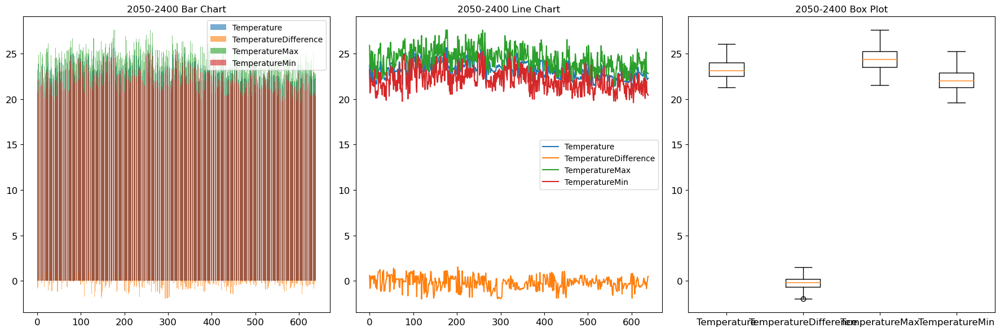

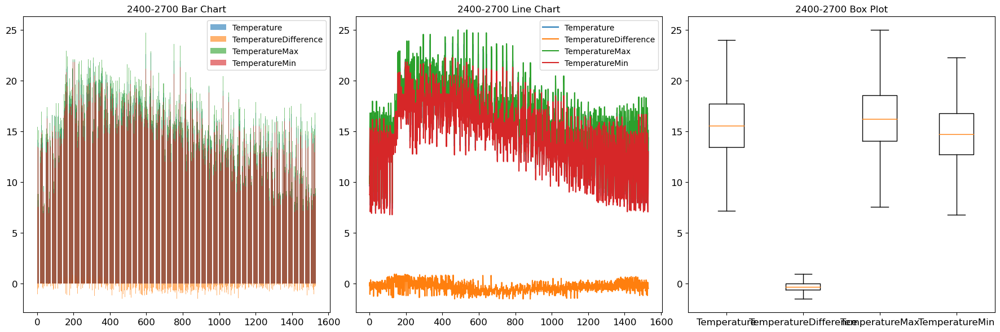

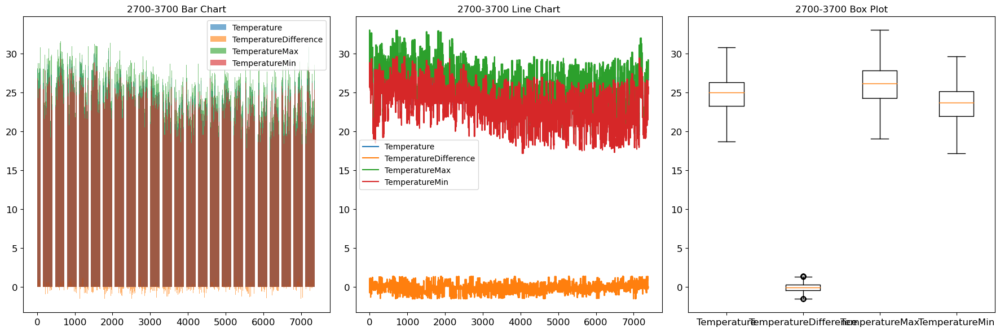

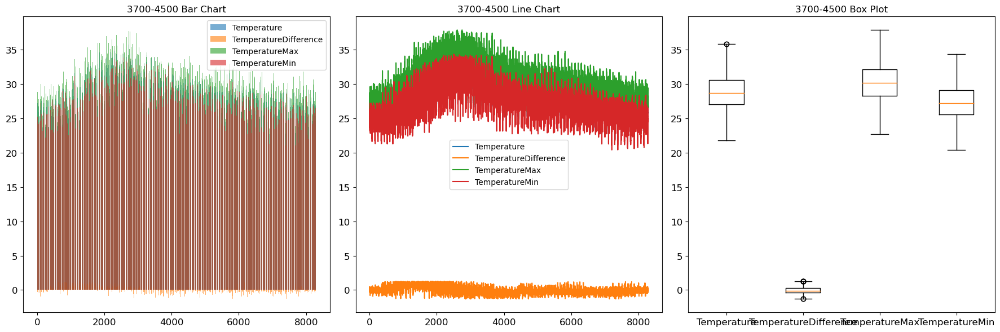

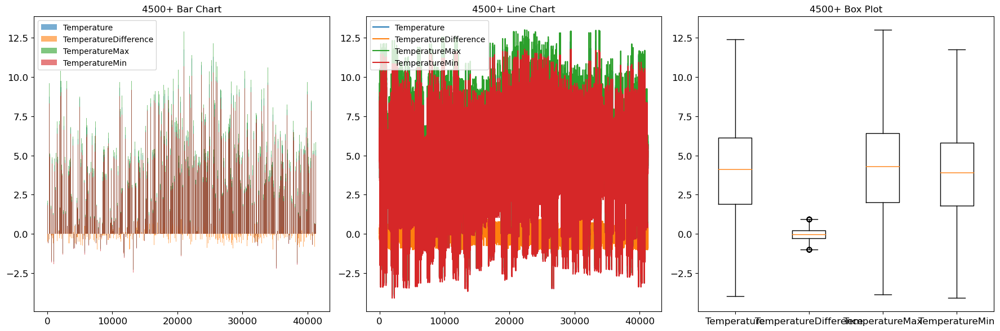

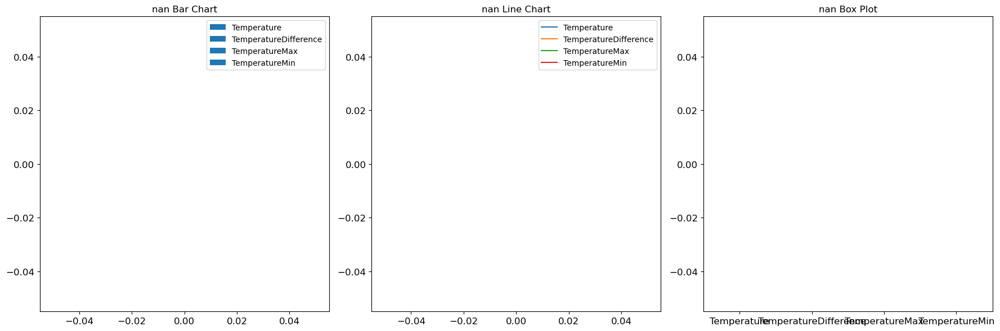

In [44]:
# Ensure columns are numeric
data_clean['Temperature'] = pd.to_numeric(data_clean['Temperature'], errors='coerce')
data_clean['TemperatureDifference'] = pd.to_numeric(data_clean['TemperatureDifference'], errors='coerce')
data_clean['TemperatureMax'] = pd.to_numeric(data_clean['TemperatureMax'], errors='coerce')
data_clean['TemperatureMin'] = pd.to_numeric(data_clean['TemperatureMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_temperature = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['Range'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_temperature.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the columns to process
temperature_columns = ['Temperature', 'TemperatureDifference', 'TemperatureMax', 'TemperatureMin']

# Clean data and plot charts for temperature variables
cleaned_temperature_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, temperature_columns)
    cleaned_temperature_data = pd.concat([cleaned_temperature_data, cleaned_city_data])

In [45]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices_temperature if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [46]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City,Range
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.000000,0.000000,...,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050,2000-2050
4043,9.744932,11.553929,4.307683,4.598571,4.051276,2014.880103,1,0.000000,0.000000,0.000000,...,0.0,9227.175577,10123.732180,8907.403949,166.366561,0.000000,0.164778,0.000000,2000-2050,2000-2050
4045,12.119808,11.576843,4.307689,4.656046,4.289778,2021.758151,1,0.000000,0.000000,0.000000,...,0.0,7627.097470,7964.348148,7270.186873,81.559869,0.157084,0.172166,0.156641,2000-2050,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149180,3.951684,12.559154,6.160990,6.175625,6.141321,4824.905595,1,0.000000,0.000000,0.000000,...,23.0,23925.113510,24565.879630,22265.722960,93.382563,0.496921,1.294696,0.491408,4500+,4500+
149181,4.468772,12.249670,6.077392,6.355667,6.063814,4824.539288,0,7.991518,8.426825,7.421674,...,23.0,21407.133060,22463.406130,20601.863430,54.324022,1.663570,2.502187,1.595404,4500+,4500+
149183,4.059128,12.580853,6.089261,6.109443,5.943323,4823.728580,0,0.000000,0.000000,0.000000,...,23.0,24833.599840,25688.443920,24022.324980,84.362159,0.455441,1.002324,0.410861,4500+,4500+
149219,7.505462,14.707128,5.319522,5.849792,5.050074,4820.083140,0,67.102368,71.693014,65.355973,...,23.0,16420.886580,16574.228980,15182.881330,97.515301,0.738507,7.761041,0.674089,4500+,4500+


Visibility/Max/Min(Column21-23):'Visibility' refers to the maximum distance at which an object or light can be clearly perceived under specific weather conditions. 'VisibilityMax/Min' denotes the most/least distance of visibility recorded during the observation period.

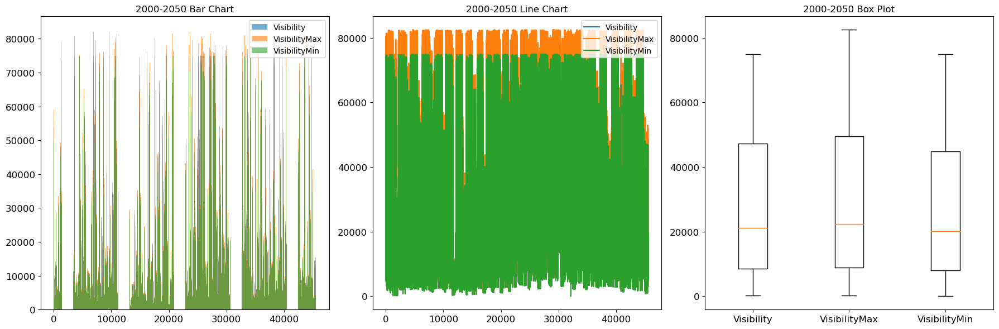

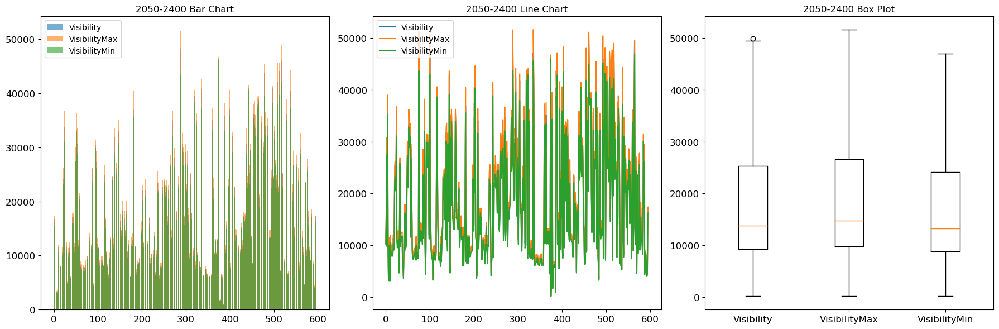

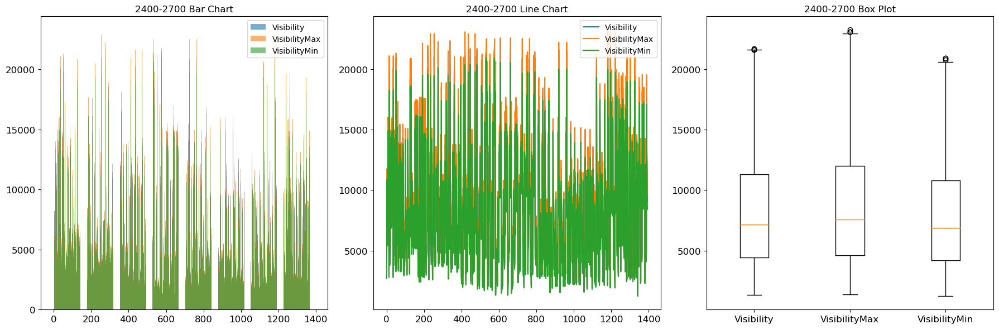

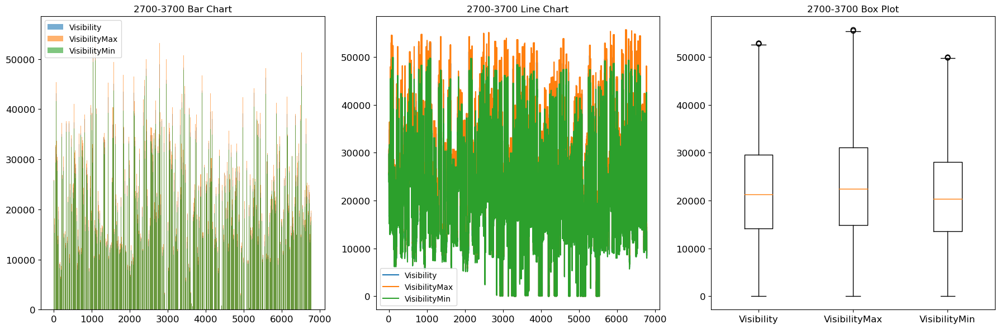

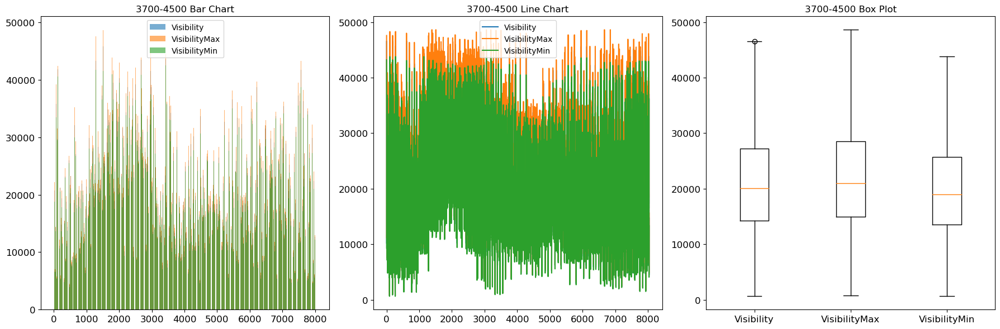

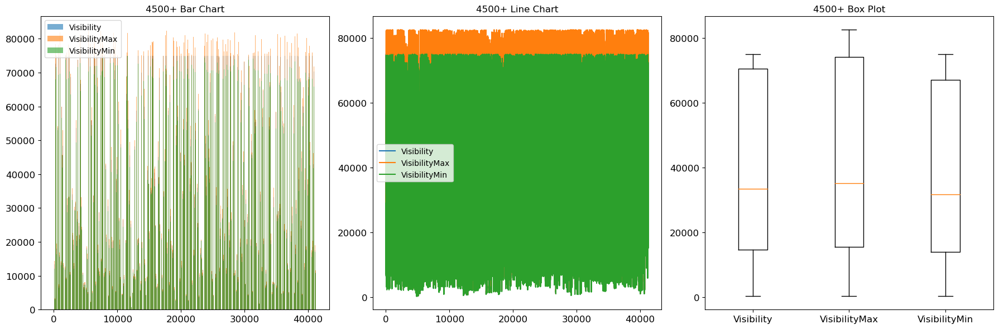

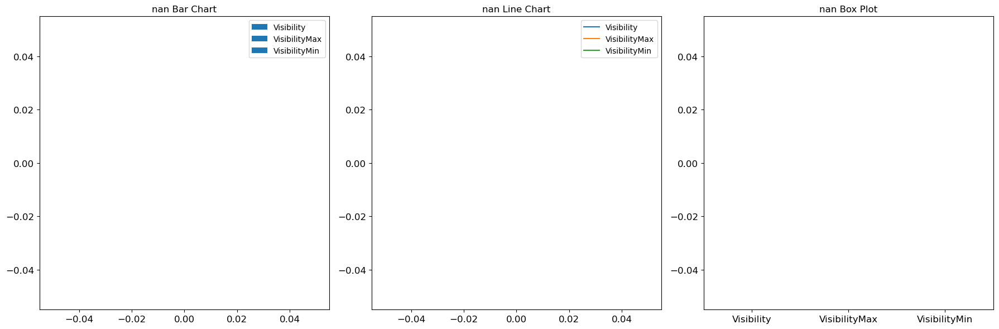

In [47]:
# Ensure columns are numeric
data_clean['Visibility'] = pd.to_numeric(data_clean['Visibility'], errors='coerce')
data_clean['VisibilityMax'] = pd.to_numeric(data_clean['VisibilityMax'], errors='coerce')
data_clean['VisibilityMin'] = pd.to_numeric(data_clean['VisibilityMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_visibility = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['Range'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_visibility.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the columns to process
visibility_columns = ['Visibility', 'VisibilityMax', 'VisibilityMin']

# Clean data and plot charts for visibility variables
cleaned_visibility_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, visibility_columns)
    cleaned_visibility_data = pd.concat([cleaned_visibility_data, cleaned_city_data])

In [48]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices_visibility if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [49]:
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City,Range
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050,2000-2050
3981,8.619152,11.000919,4.155652,4.415508,4.146886,2013.672782,0,0.000000,0.000000,0.000000,...,0.0,20078.400190,20684.238120,19459.289110,128.438567,0.000000,0.672846,0.000000,2000-2050,2000-2050
4043,9.744932,11.553929,4.307683,4.598571,4.051276,2014.880103,1,0.000000,0.000000,0.000000,...,0.0,9227.175577,10123.732180,8907.403949,166.366561,0.000000,0.164778,0.000000,2000-2050,2000-2050
4045,12.119808,11.576843,4.307689,4.656046,4.289778,2021.758151,1,0.000000,0.000000,0.000000,...,0.0,7627.097470,7964.348148,7270.186873,81.559869,0.157084,0.172166,0.156641,2000-2050,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149180,3.951684,12.559154,6.160990,6.175625,6.141321,4824.905595,1,0.000000,0.000000,0.000000,...,23.0,23925.113510,24565.879630,22265.722960,93.382563,0.496921,1.294696,0.491408,4500+,4500+
149181,4.468772,12.249670,6.077392,6.355667,6.063814,4824.539288,0,7.991518,8.426825,7.421674,...,23.0,21407.133060,22463.406130,20601.863430,54.324022,1.663570,2.502187,1.595404,4500+,4500+
149183,4.059128,12.580853,6.089261,6.109443,5.943323,4823.728580,0,0.000000,0.000000,0.000000,...,23.0,24833.599840,25688.443920,24022.324980,84.362159,0.455441,1.002324,0.410861,4500+,4500+
149219,7.505462,14.707128,5.319522,5.849792,5.050074,4820.083140,0,67.102368,71.693014,65.355973,...,23.0,16420.886580,16574.228980,15182.881330,97.515301,0.738507,7.761041,0.674089,4500+,4500+


WindDirection(Column24): 'Wind Direction' is defined as the direction from which the wind originates.

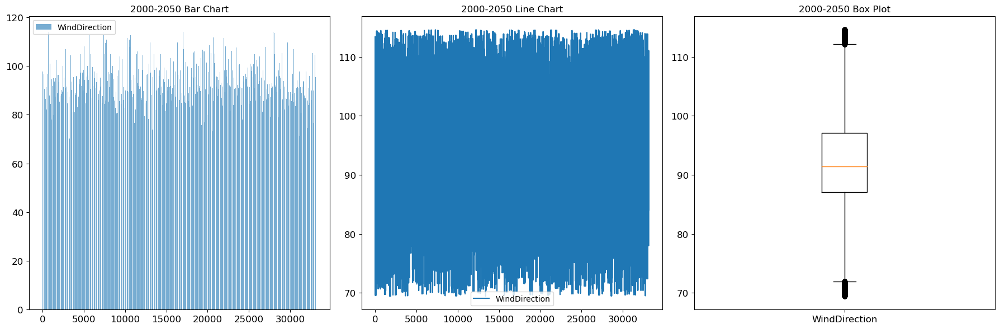

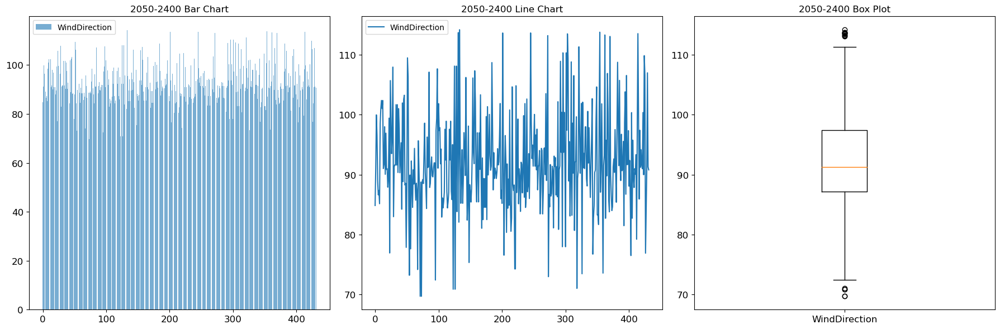

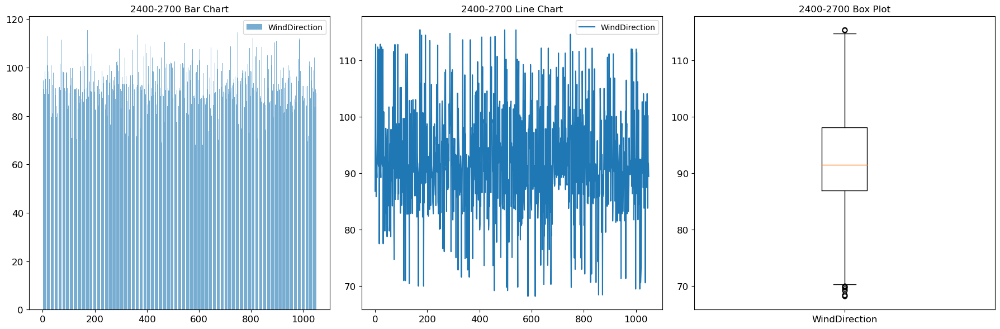

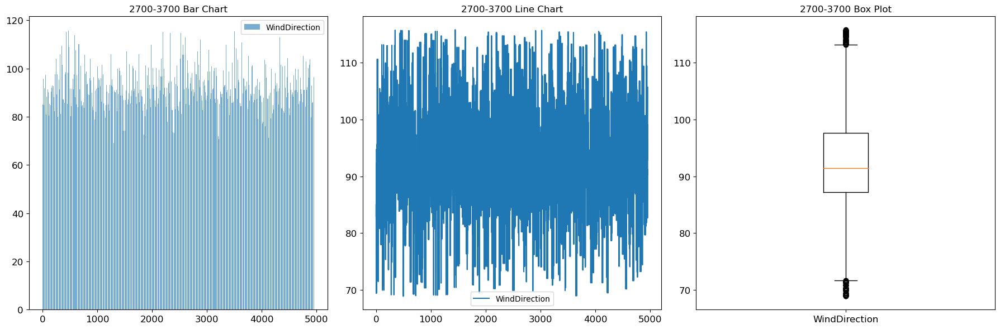

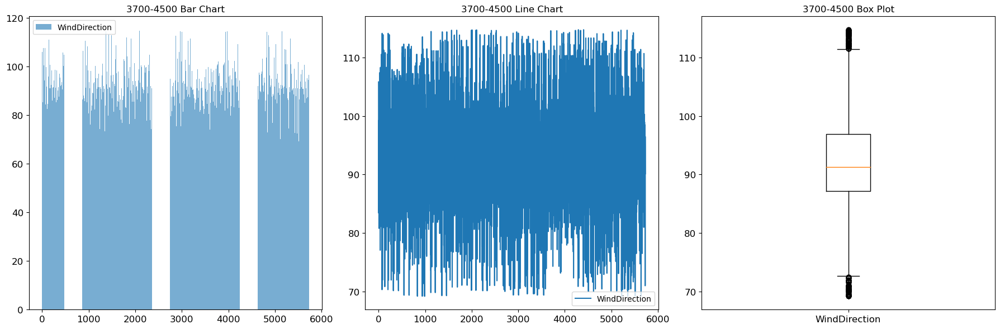

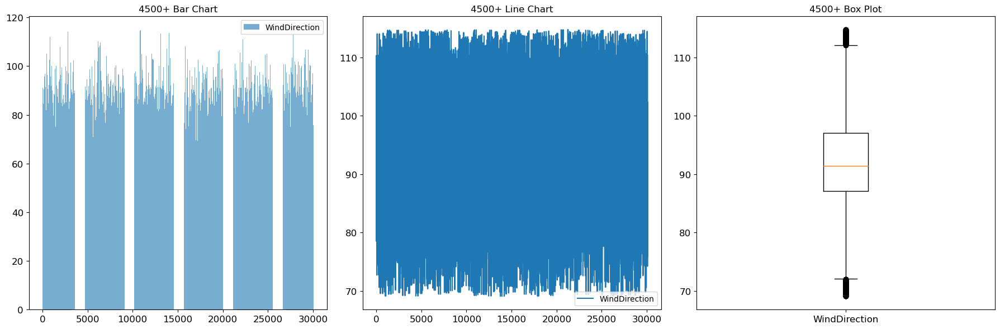

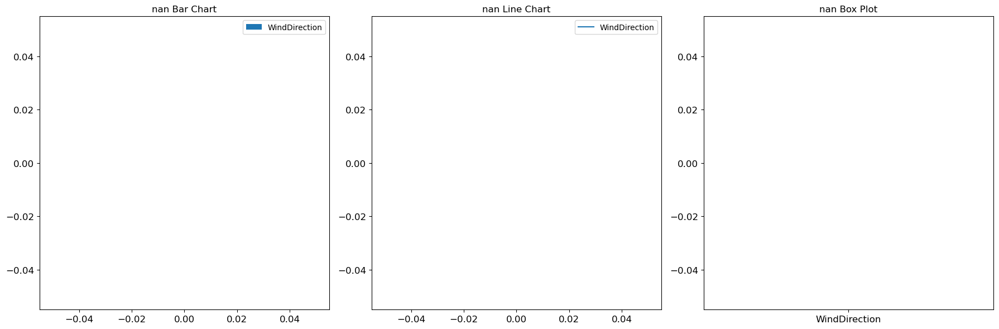

In [50]:
# Ensure column is numeric
data_clean['WindDirection'] = pd.to_numeric(data_clean['WindDirection'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_wind_direction = set()

def plot_city_charts(city_label, original_data, column):
    city_data = original_data[original_data['Range'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively for all ranges
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, column)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_wind_direction.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=[column])

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot(city_data[column], labels=[column])
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the column to process
wind_direction_column = 'WindDirection'

# Clean data and plot charts for wind direction variable
cleaned_wind_direction_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, wind_direction_column)
    cleaned_wind_direction_data = pd.concat([cleaned_wind_direction_data, cleaned_city_data])

In [51]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices_wind_direction if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [52]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City,Range
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050,2000-2050
4045,12.119808,11.576843,4.307689,4.656046,4.289778,2021.758151,1,0.000000,0.000000,0.000000,...,0.0,7627.097470,7964.348148,7270.186873,81.559869,0.157084,0.172166,0.156641,2000-2050,2000-2050
4132,11.919433,11.546763,4.682600,4.852692,4.442442,2015.918268,1,0.000000,0.000000,0.000000,...,0.0,6426.736203,6663.720589,6109.938480,69.592747,0.216630,0.439011,0.214567,2000-2050,2000-2050
4134,12.773582,11.537573,4.551267,4.604498,4.425230,2020.644719,1,0.000000,0.000000,0.000000,...,0.0,6588.696168,7229.031955,6446.192868,81.560993,0.183917,0.268695,0.183425,2000-2050,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149179,4.216975,12.969554,6.201412,6.233785,5.930360,4821.533321,0,0.000000,0.000000,0.000000,...,23.0,25699.813210,25887.334300,24520.157920,91.465598,0.518135,2.317070,0.487352,4500+,4500+
149180,3.951684,12.559154,6.160990,6.175625,6.141321,4824.905595,1,0.000000,0.000000,0.000000,...,23.0,23925.113510,24565.879630,22265.722960,93.382563,0.496921,1.294696,0.491408,4500+,4500+
149183,4.059128,12.580853,6.089261,6.109443,5.943323,4823.728580,0,0.000000,0.000000,0.000000,...,23.0,24833.599840,25688.443920,24022.324980,84.362159,0.455441,1.002324,0.410861,4500+,4500+
149219,7.505462,14.707128,5.319522,5.849792,5.050074,4820.083140,0,67.102368,71.693014,65.355973,...,23.0,16420.886580,16574.228980,15182.881330,97.515301,0.738507,7.761041,0.674089,4500+,4500+


WindSpeed/Max/Min(Column25-27): 'WindSpeed' refers to the rate at which wind moves across a given point. 'WindSpeedMax/Min' denotes the highest/lowest wind speed recorded during the observation period.

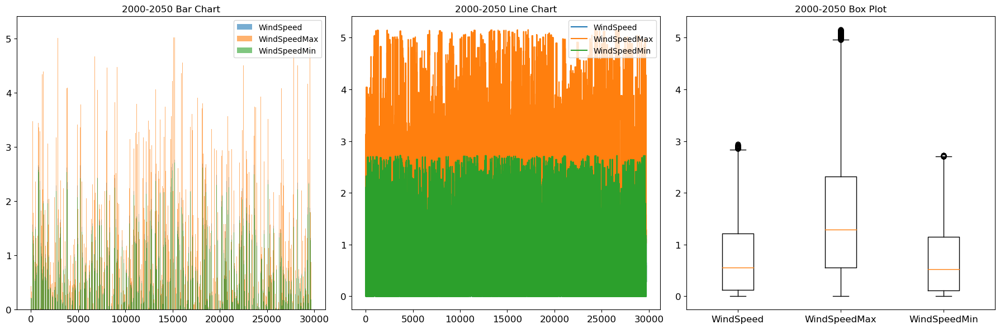

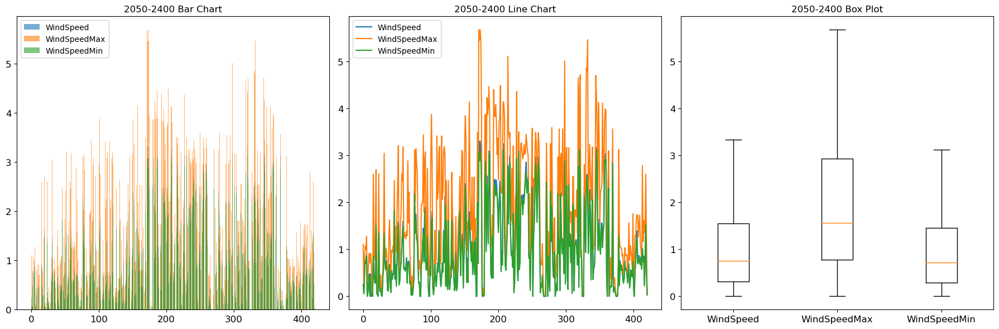

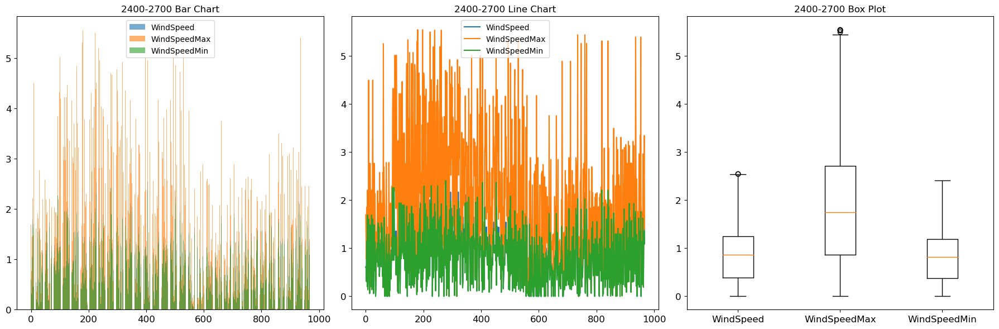

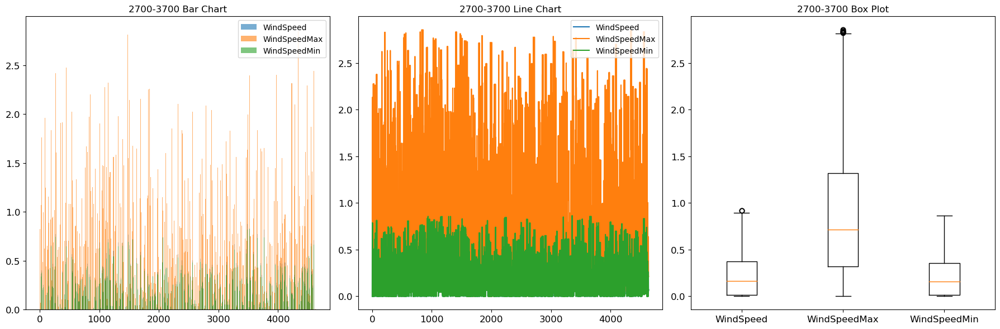

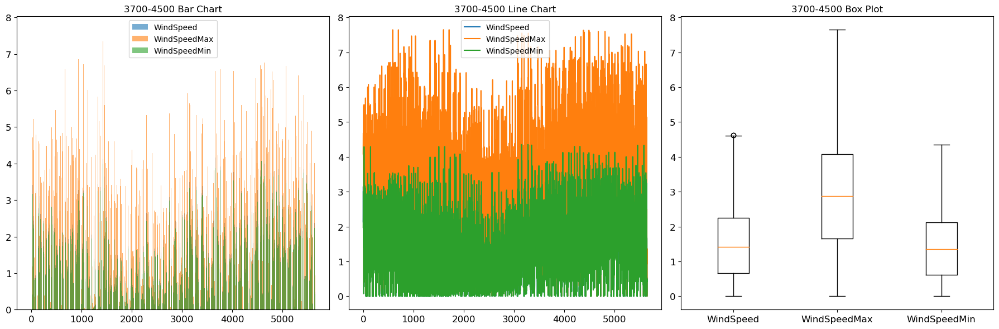

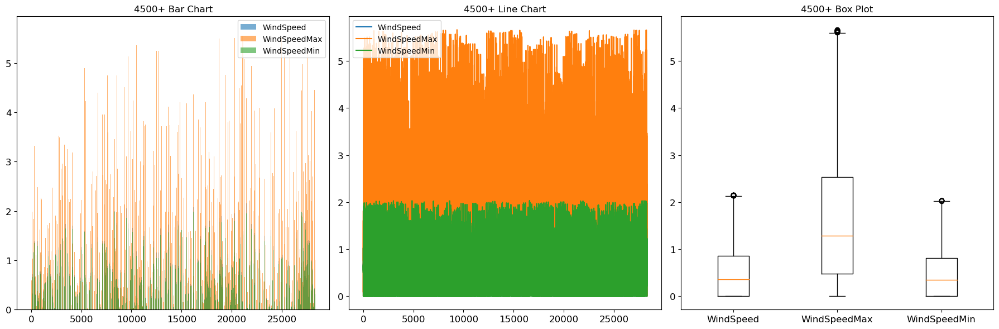

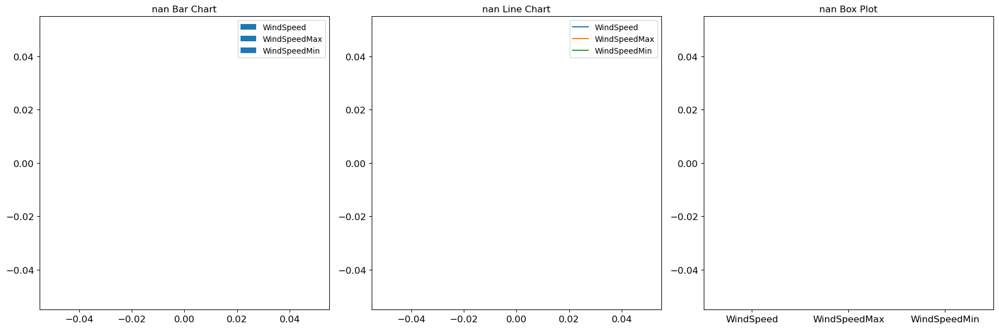

In [53]:
# Ensure columns are numeric
data_clean['WindSpeed'] = pd.to_numeric(data_clean['WindSpeed'], errors='coerce')
data_clean['WindSpeedMax'] = pd.to_numeric(data_clean['WindSpeedMax'], errors='coerce')
data_clean['WindSpeedMin'] = pd.to_numeric(data_clean['WindSpeedMin'], errors='coerce')

# Function to remove outliers using IQR
def remove_outliers(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Define function to plot charts and collect deleted indices
deleted_indices_wind_speed = set()

def plot_city_charts(city_label, original_data, columns):
    city_data = original_data[original_data['Range'] == city_label]
    original_indices = city_data.index
    
    # Remove outliers iteratively for all ranges
    for _ in range(2):  # Increase iterations if necessary
        city_data = remove_outliers(city_data, columns)
    
    # Collect deleted indices
    remaining_indices = set(city_data.index)
    deleted_indices_wind_speed.update(original_indices.difference(remaining_indices))
    
    # Remove rows with missing values in the specified columns
    city_data = city_data.dropna(subset=columns)

    # Reset the index to ensure continuity
    city_data.reset_index(drop=True, inplace=True)
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    
    # Plot bar charts
    for column in columns:
        axs[0].bar(city_data.index, city_data[column], alpha=0.6, label=column)
    axs[0].set_title(f'{city_label} Bar Chart')
    axs[0].legend()
    
    # Plot line charts
    for column in columns:
        axs[1].plot(city_data.index, city_data[column], label=column)
    axs[1].set_title(f'{city_label} Line Chart')
    axs[1].legend()
    
    # Plot box plots
    axs[2].boxplot([city_data[column] for column in columns], labels=columns)
    axs[2].set_title(f'{city_label} Box Plot')
    
    plt.tight_layout()
    plt.show()
    
    return city_data

# Define the columns to process
wind_speed_columns = ['WindSpeed', 'WindSpeedMax', 'WindSpeedMin']

# Clean data and plot charts for wind speed variables
cleaned_wind_speed_data = pd.DataFrame()
for city_label in unique_cities:
    cleaned_city_data = plot_city_charts(city_label, data_clean, wind_speed_columns)
    cleaned_wind_speed_data = pd.concat([cleaned_wind_speed_data, cleaned_city_data])

In [54]:
# Remove the collected indices from data_clean
valid_deleted_indices = [index for index in deleted_indices_wind_speed if index in data_clean.index]
data_clean = data_clean.drop(valid_deleted_indices)

In [55]:
# Resulting dataset
data_clean

,FSO_Att,RFL_Att,AbsoluteHumidityAve,AbsoluteHumidityMax,AbsoluteHumidityMin,Distance,Frequency,Particulate,ParticulateMax,ParticulateMin,...,Time,Visibility,VisibilityMax,VisibilityMin,WindDirection,WindSpeed,WindSpeedMax,WindSpeedMin,City,Range
3791,10.179389,11.841536,5.232913,5.748283,4.971359,2019.787270,0,0.000000,0.000000,0.000000,...,0.0,10985.529930,11557.153680,10252.374960,85.484875,1.140640,1.529640,1.035908,2000-2050,2000-2050
3792,10.198811,11.544408,5.279997,5.709268,4.913893,2019.808808,1,0.000000,0.000000,0.000000,...,0.0,10477.237790,11249.652520,9573.364080,91.371454,1.068922,1.286637,0.992577,2000-2050,2000-2050
4045,12.119808,11.576843,4.307689,4.656046,4.289778,2021.758151,1,0.000000,0.000000,0.000000,...,0.0,7627.097470,7964.348148,7270.186873,81.559869,0.157084,0.172166,0.156641,2000-2050,2000-2050
4132,11.919433,11.546763,4.682600,4.852692,4.442442,2015.918268,1,0.000000,0.000000,0.000000,...,0.0,6426.736203,6663.720589,6109.938480,69.592747,0.216630,0.439011,0.214567,2000-2050,2000-2050
4134,12.773582,11.537573,4.551267,4.604498,4.425230,2020.644719,1,0.000000,0.000000,0.000000,...,0.0,6588.696168,7229.031955,6446.192868,81.560993,0.183917,0.268695,0.183425,2000-2050,2000-2050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149166,5.308759,12.757940,5.549148,6.024772,5.105596,4823.700830,0,0.000000,0.000000,0.000000,...,23.0,75000.396880,81692.609540,69489.575960,100.000996,0.320306,1.011789,0.303738,4500+,4500+
149179,4.216975,12.969554,6.201412,6.233785,5.930360,4821.533321,0,0.000000,0.000000,0.000000,...,23.0,25699.813210,25887.334300,24520.157920,91.465598,0.518135,2.317070,0.487352,4500+,4500+
149180,3.951684,12.559154,6.160990,6.175625,6.141321,4824.905595,1,0.000000,0.000000,0.000000,...,23.0,23925.113510,24565.879630,22265.722960,93.382563,0.496921,1.294696,0.491408,4500+,4500+
149183,4.059128,12.580853,6.089261,6.109443,5.943323,4823.728580,0,0.000000,0.000000,0.000000,...,23.0,24833.599840,25688.443920,24022.324980,84.362159,0.455441,1.002324,0.410861,4500+,4500+


### 2.4 correlation

In the next step, we will discuss the correlation of the variables.

Firstly, we exclude the categorical variables and divide the dataset into six cities according to the original classification method, and make the Pearson correlation plots of the other variables except this one on FSO_Att and RFL_Att respectively.

In [56]:
# Function to calculate Pearson correlations for a given city and response variable
def calculate_correlations(city_label, df, variables, response):
    city_data = df[df['City'] == city_label]
    return city_data[variables + [response]].corr()[response][:-1]

# Define the columns to process
humidity_columns = ['AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin']
particulate_columns = ['Particulate', 'ParticulateMax', 'ParticulateMin']
rain_columns = ['RainIntensity', 'RainIntensityMax', 'RainIntensityMin', 'RelativeHumidity']
temperature_columns = ['Temperature', 'TemperatureDifference', 'TemperatureMax', 'TemperatureMin']
visibility_columns = ['Visibility', 'VisibilityMax', 'VisibilityMin']
wind_columns = ['WindDirection', 'WindSpeed', 'WindSpeedMax', 'WindSpeedMin']

# Combine all columns
all_columns = humidity_columns + ['Distance'] + particulate_columns + rain_columns + temperature_columns + visibility_columns + wind_columns

# Function to calculate correlations for each city and response variable
def calculate_all_correlations(df, response):
    correlations = {
        city: calculate_correlations(city, df, all_columns, response)
        for city in df['City'].unique()
    }
    return pd.DataFrame(correlations)

# Calculate correlations for FSO_Att
correlations_fso = calculate_all_correlations(data_clean, 'FSO_Att')

# Calculate correlations for RFL_Att
correlations_rfl = calculate_all_correlations(data_clean, 'RFL_Att')

# Display the correlation dataframes
print("FSO_Att Correlations:")
print(correlations_fso)

print("\nRFL_Att Correlations:")
print(correlations_rfl)

FSO_Att Correlations:
                       2000-2050  2050-2400  2400-2700  2700-3700  3700-4500  \
AbsoluteHumidityAve     0.158144   0.246123  -0.263078  -0.290464   0.105771   
AbsoluteHumidityMax     0.157646   0.237192  -0.257506  -0.276850   0.100028   
AbsoluteHumidityMin     0.156984   0.195713  -0.252885  -0.280945   0.099672   
Distance               -0.009424  -0.054882  -0.049874   0.039657   0.003089   
Particulate             0.729617   0.366942   0.057701   0.439853   0.282499   
ParticulateMax          0.729223   0.367262   0.056623   0.440091   0.282958   
ParticulateMin          0.729432   0.364521   0.057455   0.438971   0.281682   
RainIntensity           0.531264   0.189416        NaN  -0.002621        NaN   
RainIntensityMax        0.531182   0.189753        NaN  -0.003647        NaN   
RainIntensityMin        0.531260   0.189490        NaN  -0.002418        NaN   
RelativeHumidity        0.453519   0.228183   0.270604   0.028632  -0.135278   
Temperature       

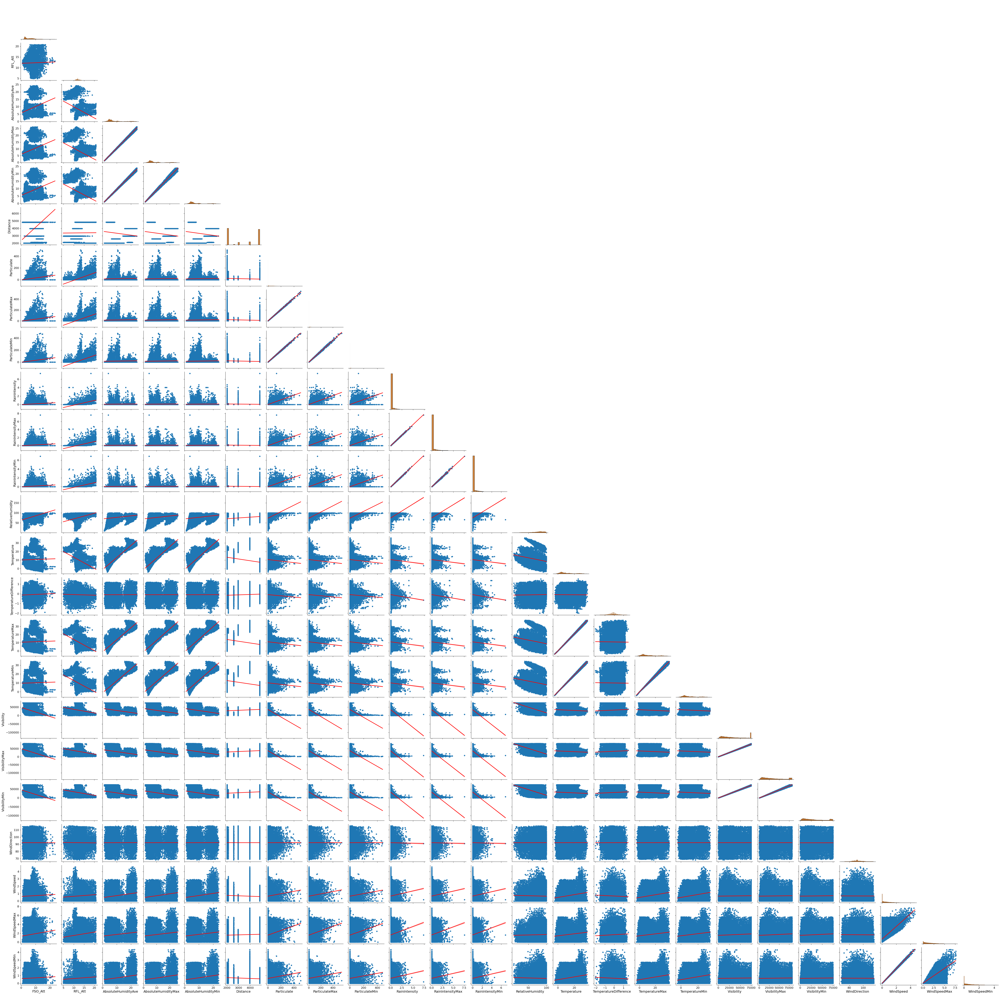

In [57]:
# Defining the corrfunc function to display Pearson correlation coefficient on the pair plot
def corrfunc(x, y, **kws):
    r, _ = stats.pearsonr(x, y)
    ax = plt.gca()
    ax.annotate(f"{r:.2f}", xy=(.1, .9), xycoords=ax.transAxes, color="red")

# Define the columns to include in the pair plot
new_cols_to_plot = [
    'FSO_Att', 'RFL_Att', 'AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin',
    'Distance', 'Particulate', 'ParticulateMax', 'ParticulateMin', 'RainIntensity', 
    'RainIntensityMax', 'RainIntensityMin', 'RelativeHumidity', 'Temperature', 
    'TemperatureDifference', 'TemperatureMax', 'TemperatureMin', 'Visibility', 
    'VisibilityMax', 'VisibilityMin', 'WindDirection', 'WindSpeed', 'WindSpeedMax', 'WindSpeedMin'
]

# Creating the pair plot with the new columns
new_pair_plot = sns.pairplot(data_clean[new_cols_to_plot], corner=True)

# Map the upper triangle for correlation values
new_pair_plot.map_upper(corrfunc)

# Map the lower triangle for scatter plots with regression line
new_pair_plot.map_lower(sns.regplot, scatter_kws={'s': 10}, line_kws={"color": "red"})

# Map the diagonal for histograms
new_pair_plot.map_diag(sns.histplot, kde_kws={'bw': 0.5})

plt.show()

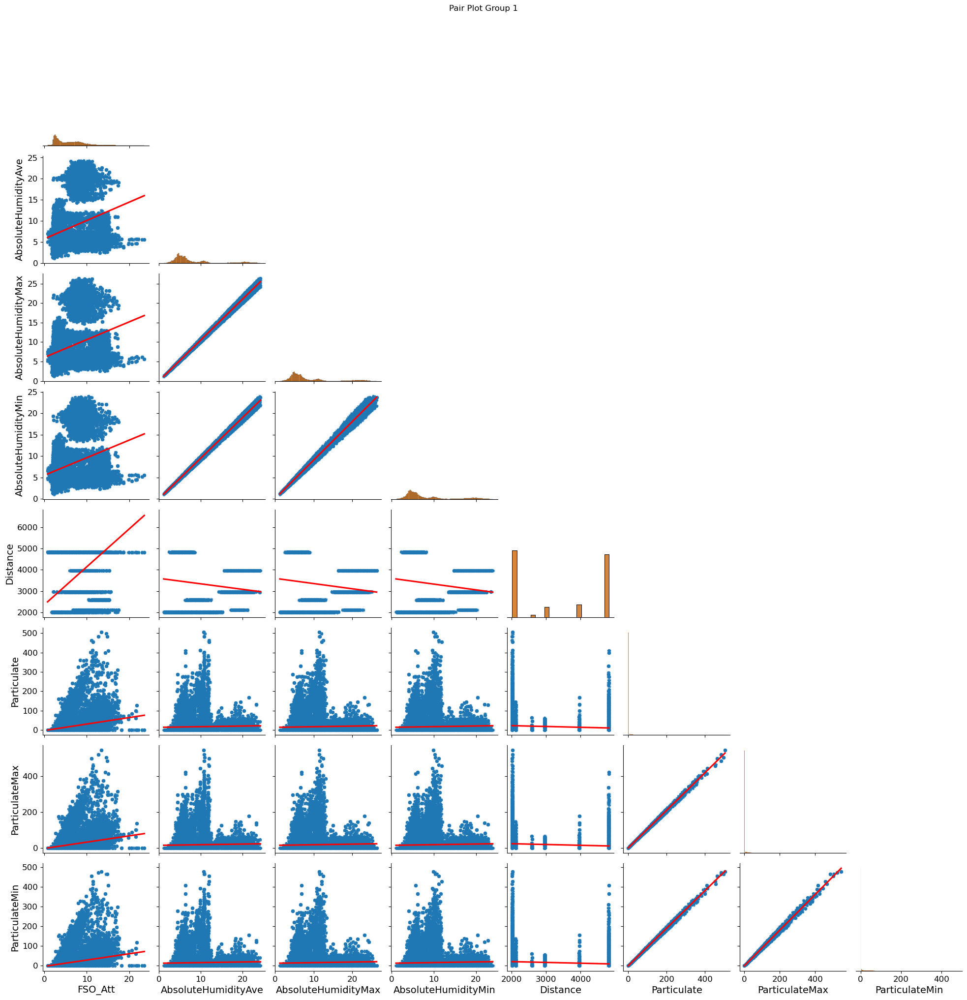

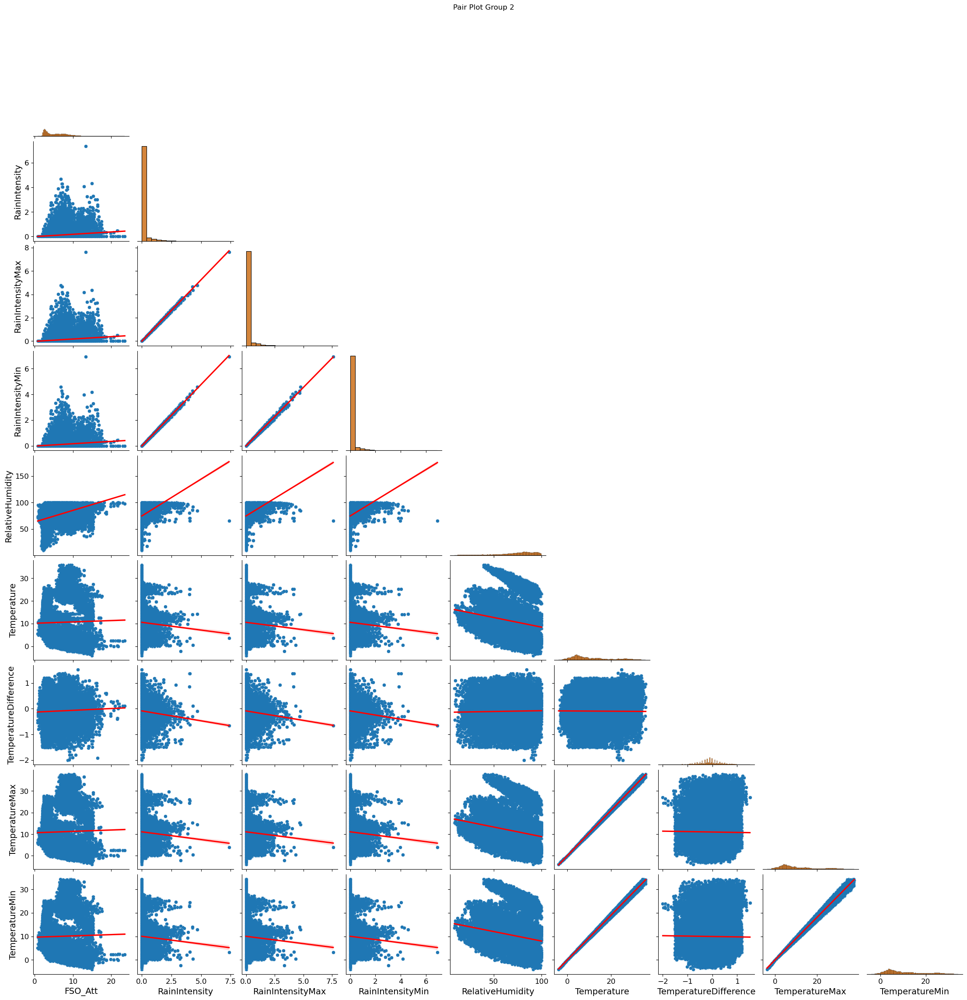

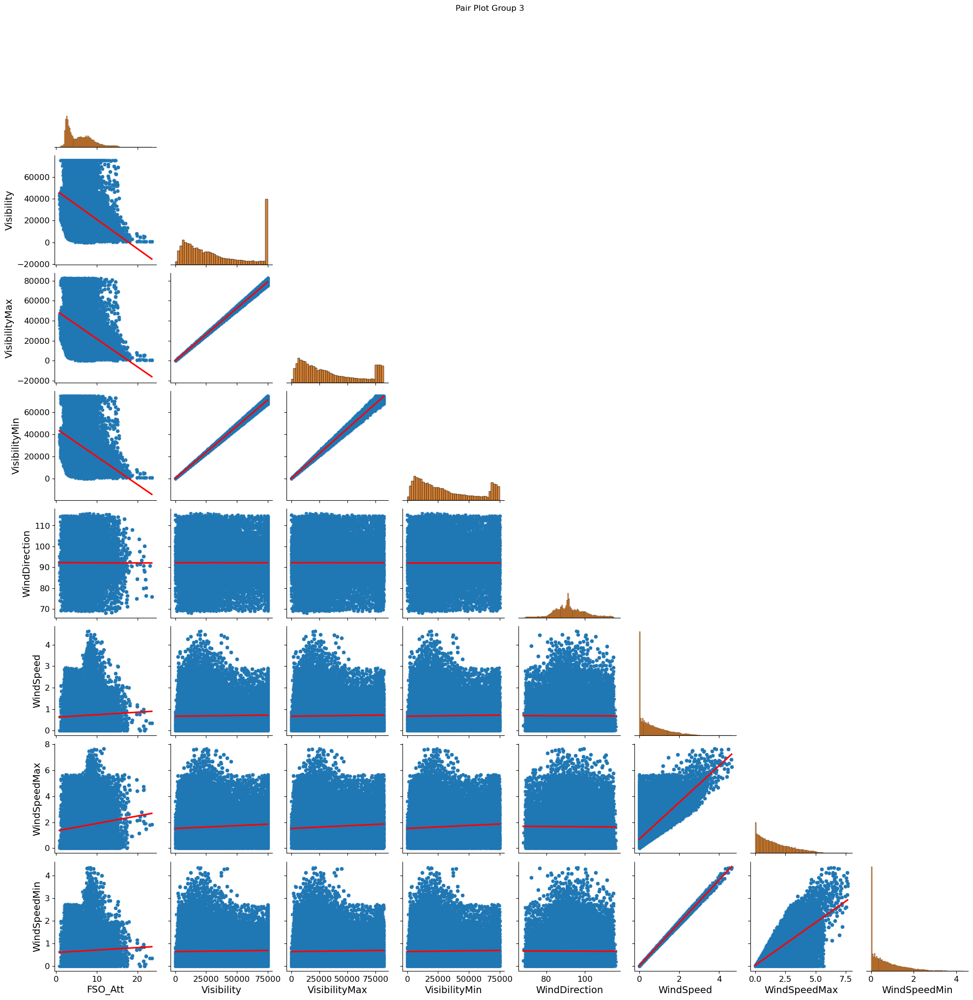

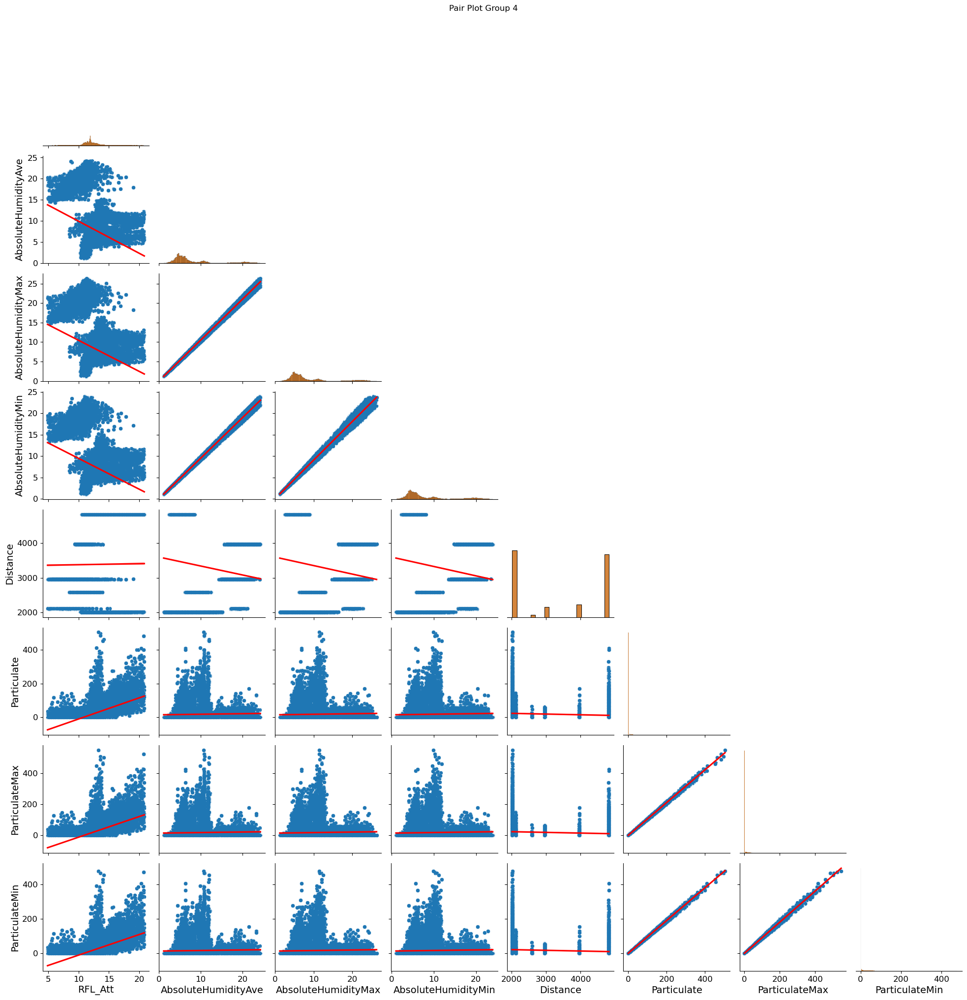

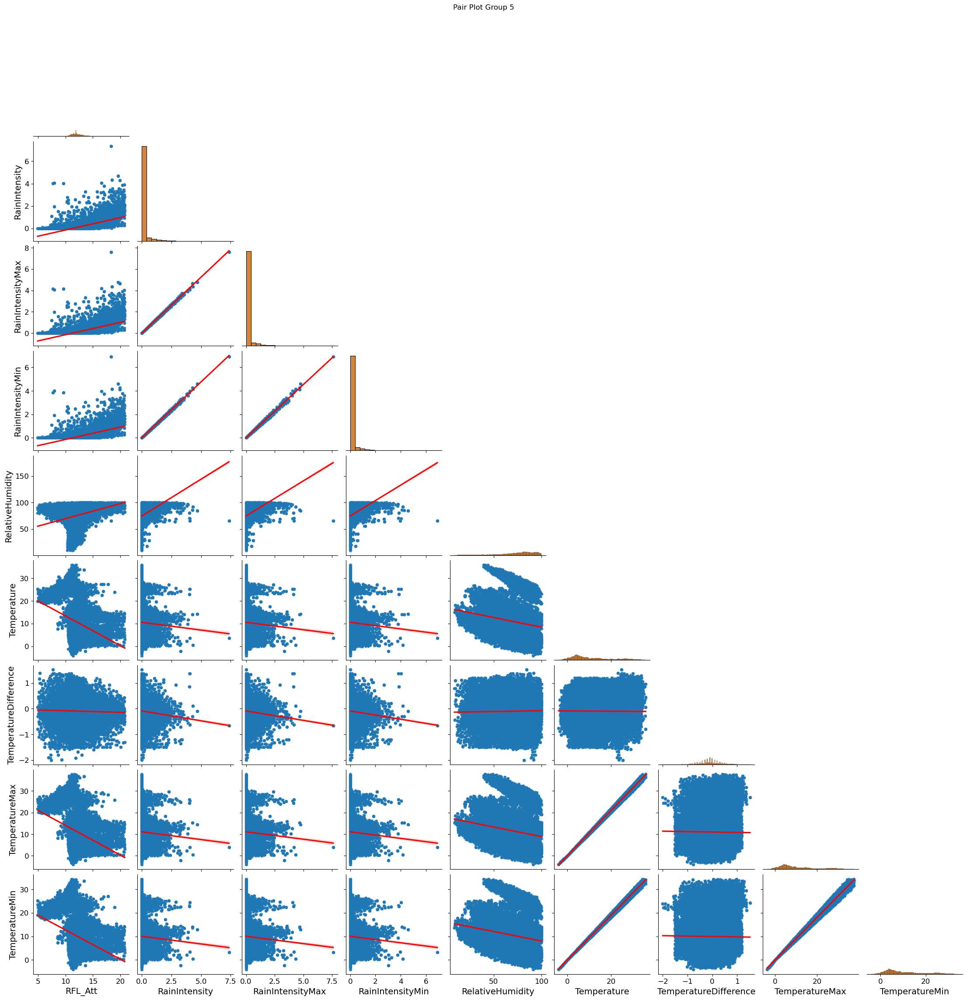

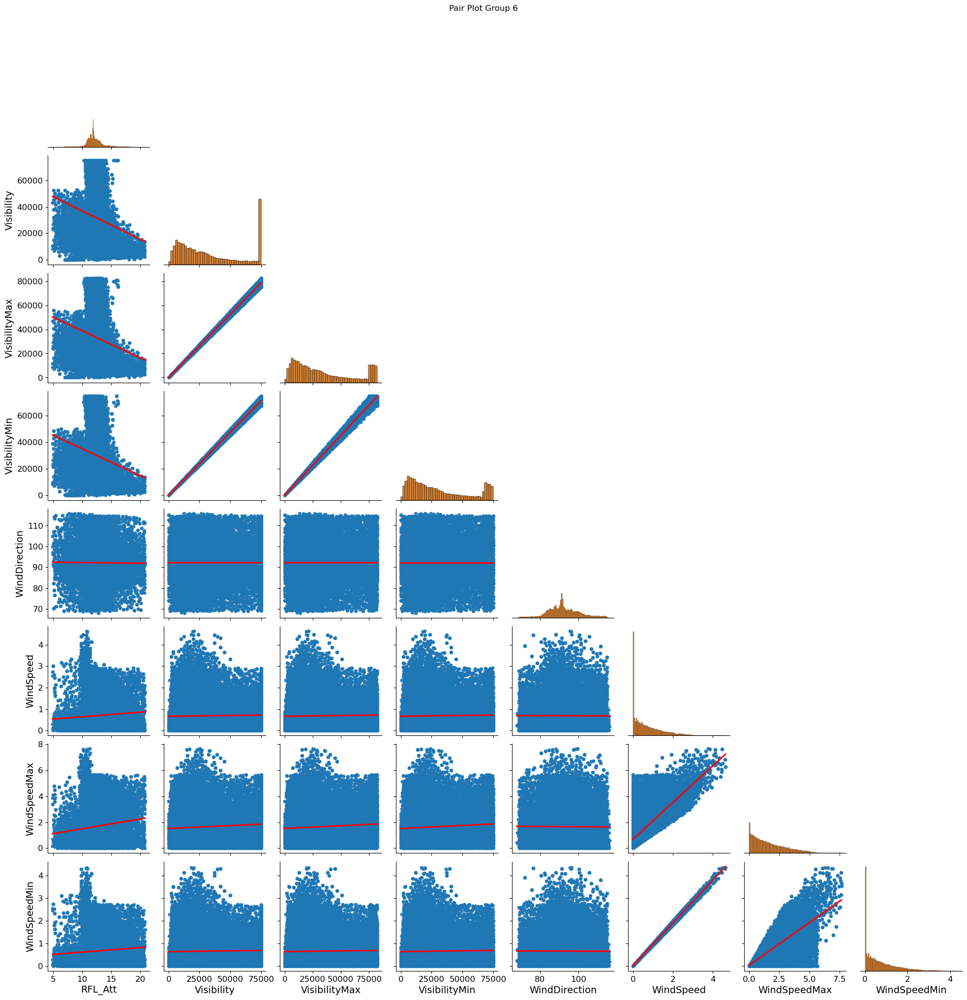

In [58]:
# Defining the corrfunc function to display Pearson correlation coefficient on the pair plot
def corrfunc(x, y, **kws):
    r, _ = stats.pearsonr(x, y)
    ax = plt.gca()
    ax.annotate(f"{r:.2f}", xy=(.1, .9), xycoords=ax.transAxes, color="red")

# Define the column groups
group1 = ['FSO_Att', 'AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin', 'Distance', 'Particulate', 'ParticulateMax', 'ParticulateMin']
group2 = ['FSO_Att', 'RainIntensity', 'RainIntensityMax', 'RainIntensityMin', 'RelativeHumidity', 'Temperature', 'TemperatureDifference', 'TemperatureMax', 'TemperatureMin']
group3 = ['FSO_Att', 'Visibility', 'VisibilityMax', 'VisibilityMin', 'WindDirection', 'WindSpeed', 'WindSpeedMax', 'WindSpeedMin']

group4 = ['RFL_Att', 'AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin', 'Distance', 'Particulate', 'ParticulateMax', 'ParticulateMin']
group5 = ['RFL_Att', 'RainIntensity', 'RainIntensityMax', 'RainIntensityMin', 'RelativeHumidity', 'Temperature', 'TemperatureDifference', 'TemperatureMax', 'TemperatureMin']
group6 = ['RFL_Att', 'Visibility', 'VisibilityMax', 'VisibilityMin', 'WindDirection', 'WindSpeed', 'WindSpeedMax', 'WindSpeedMin']

# List of all groups
groups = [group1, group2, group3, group4, group5, group6]

# Plot each group
for i, group in enumerate(groups, 1):
    # Creating the pair plot with the new columns
    new_pair_plot = sns.pairplot(data_clean[group], corner=True)

    # Map the upper triangle for correlation values
    new_pair_plot.map_upper(corrfunc)

    # Map the lower triangle for scatter plots with regression line
    new_pair_plot.map_lower(sns.regplot, scatter_kws={'s': 10}, line_kws={"color": "red"})

    # Map the diagonal for histograms
    new_pair_plot.map_diag(sns.histplot, kde_kws={'bw': 0.5})

    # Set the title for the plot
    plt.suptitle(f'Pair Plot Group {i}', y=1.02)
    
    # Show the plot
    plt.show()


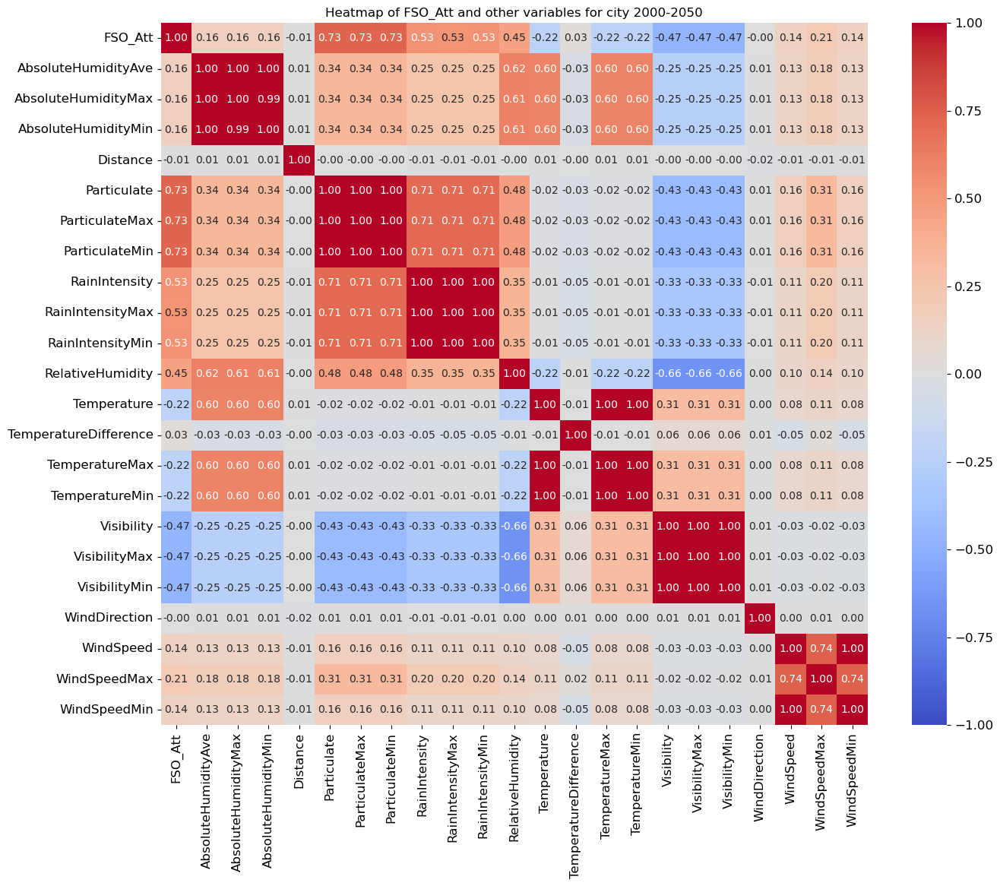

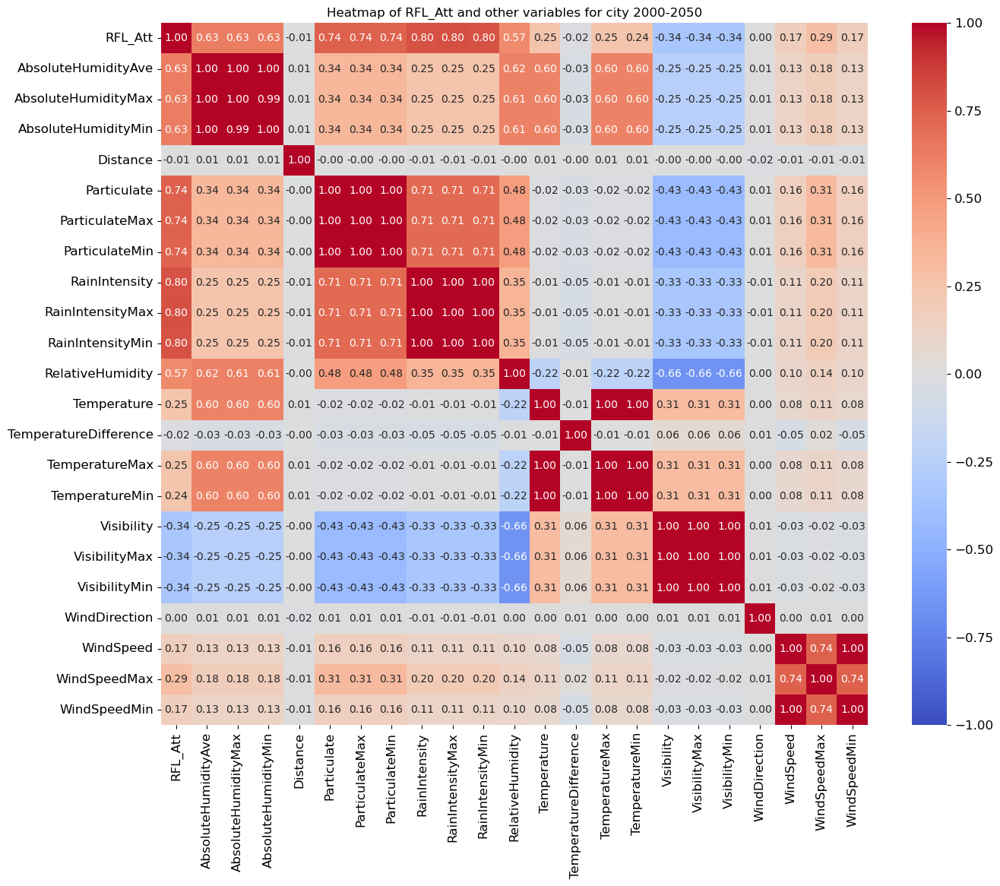

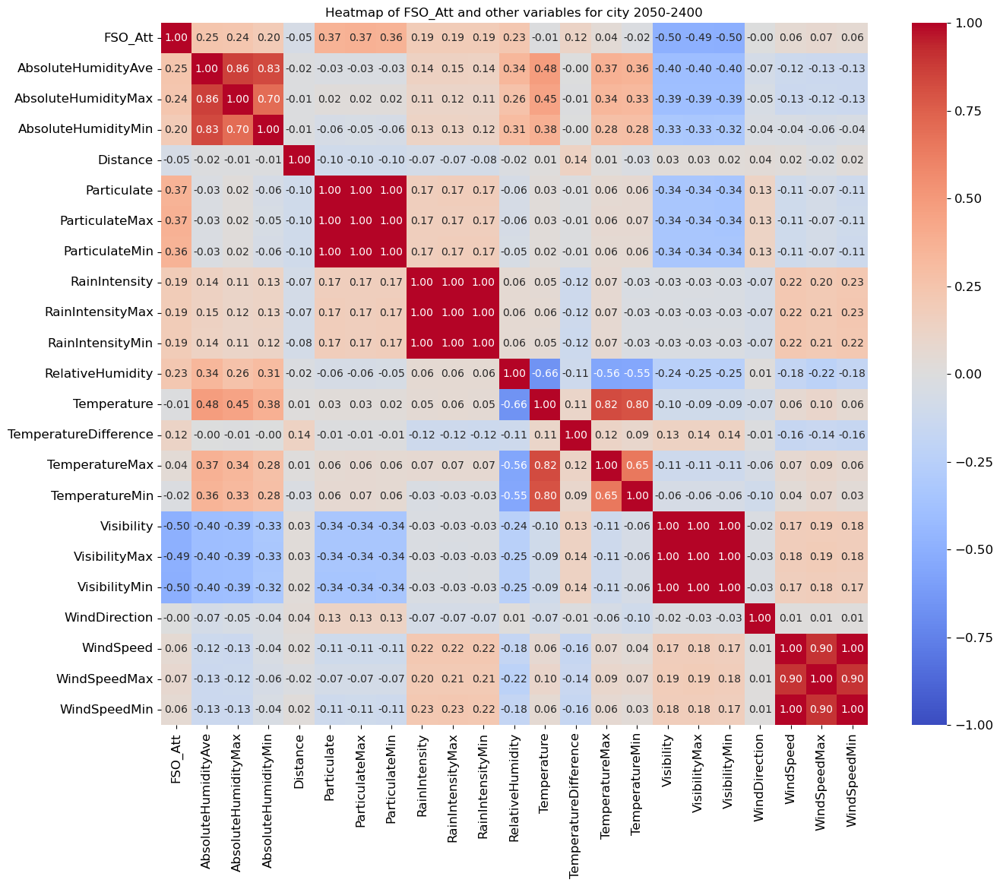

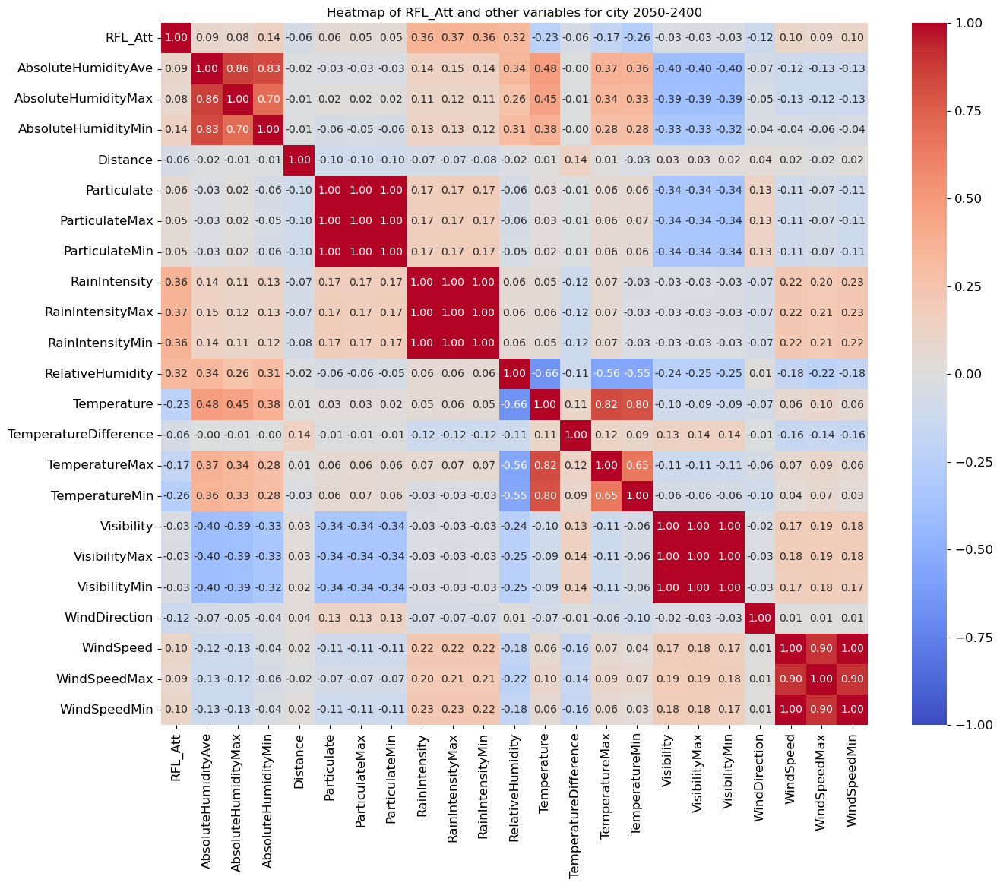

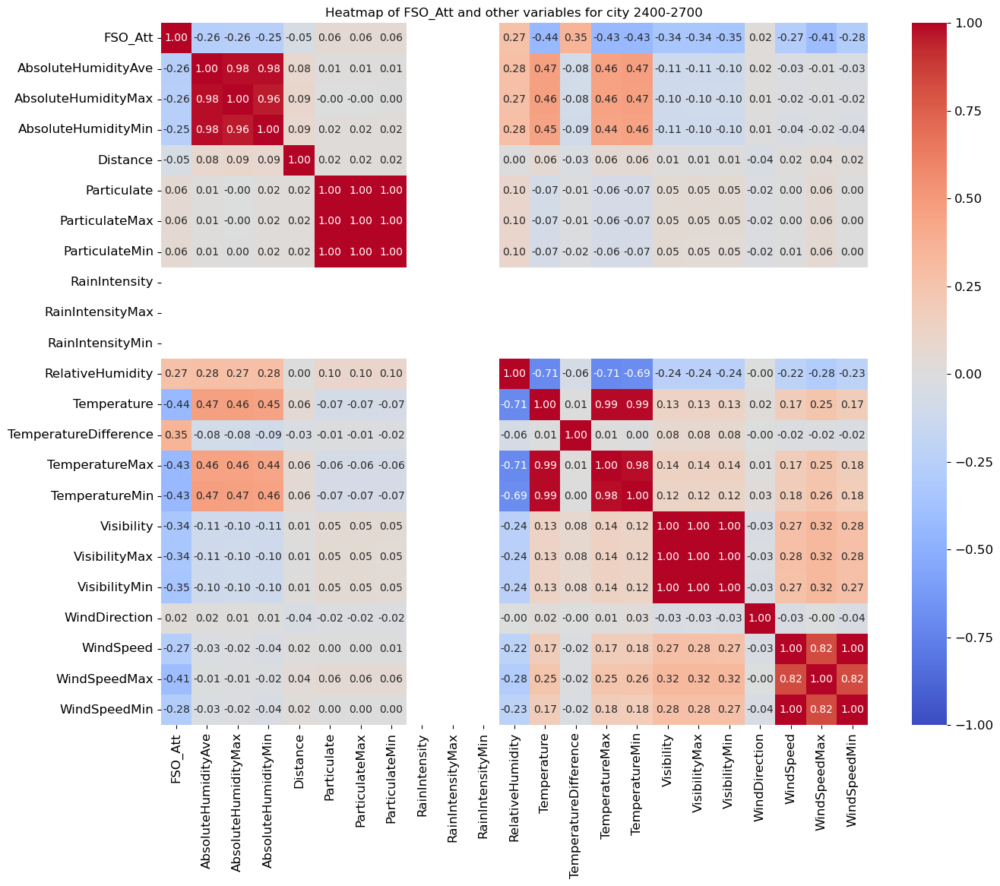

...

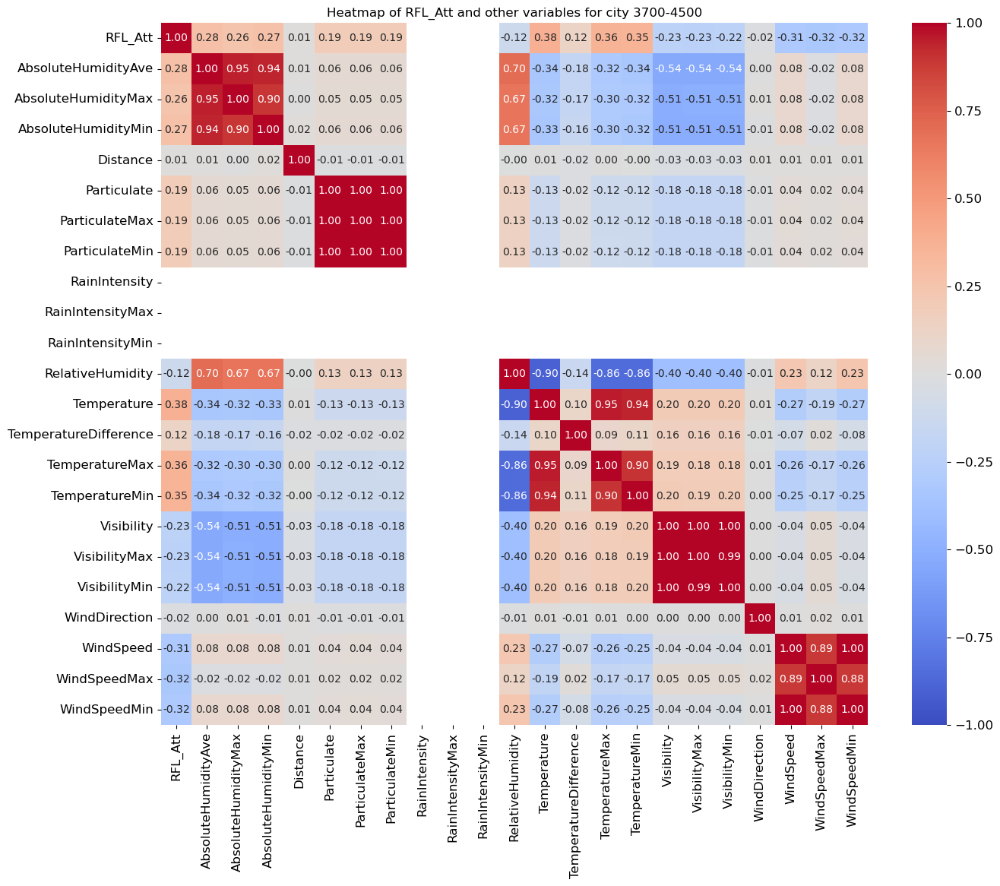

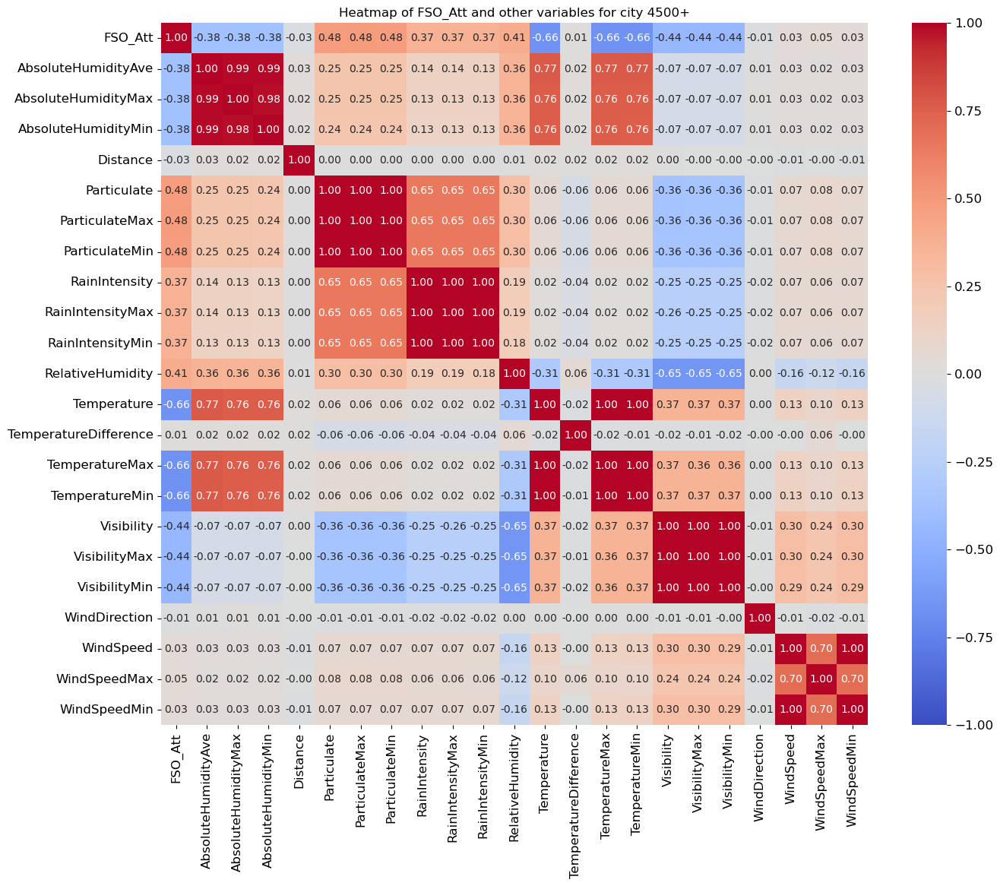

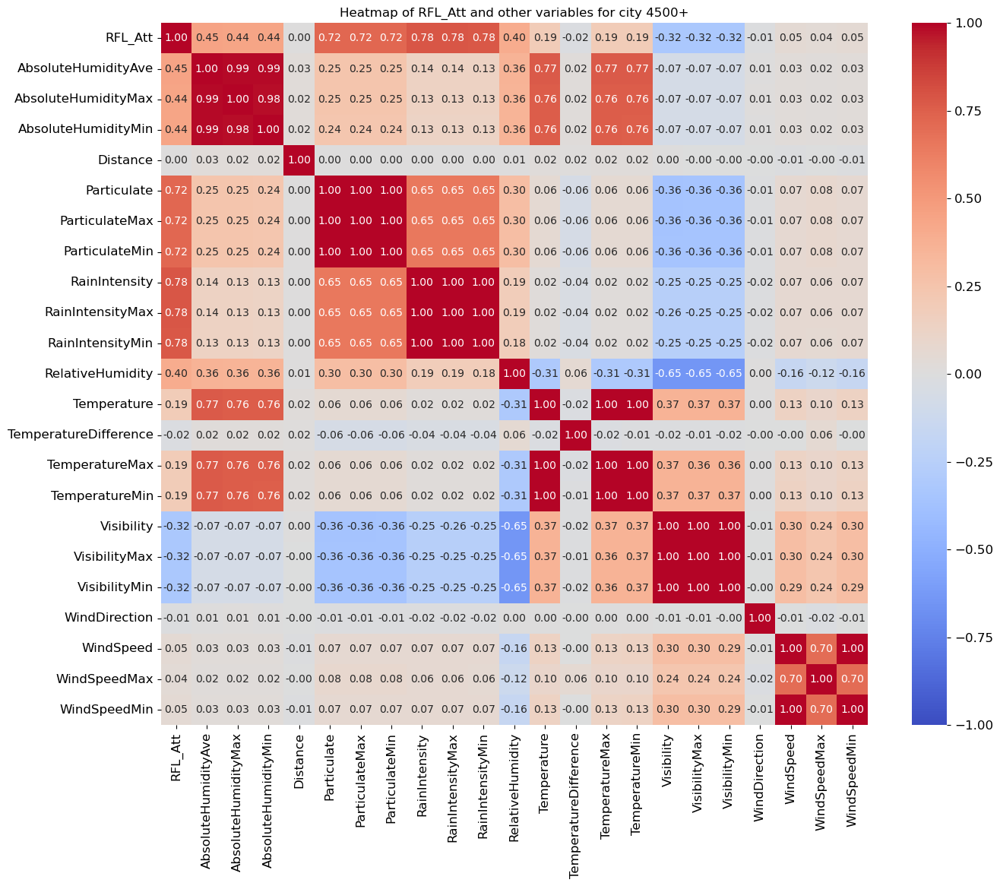

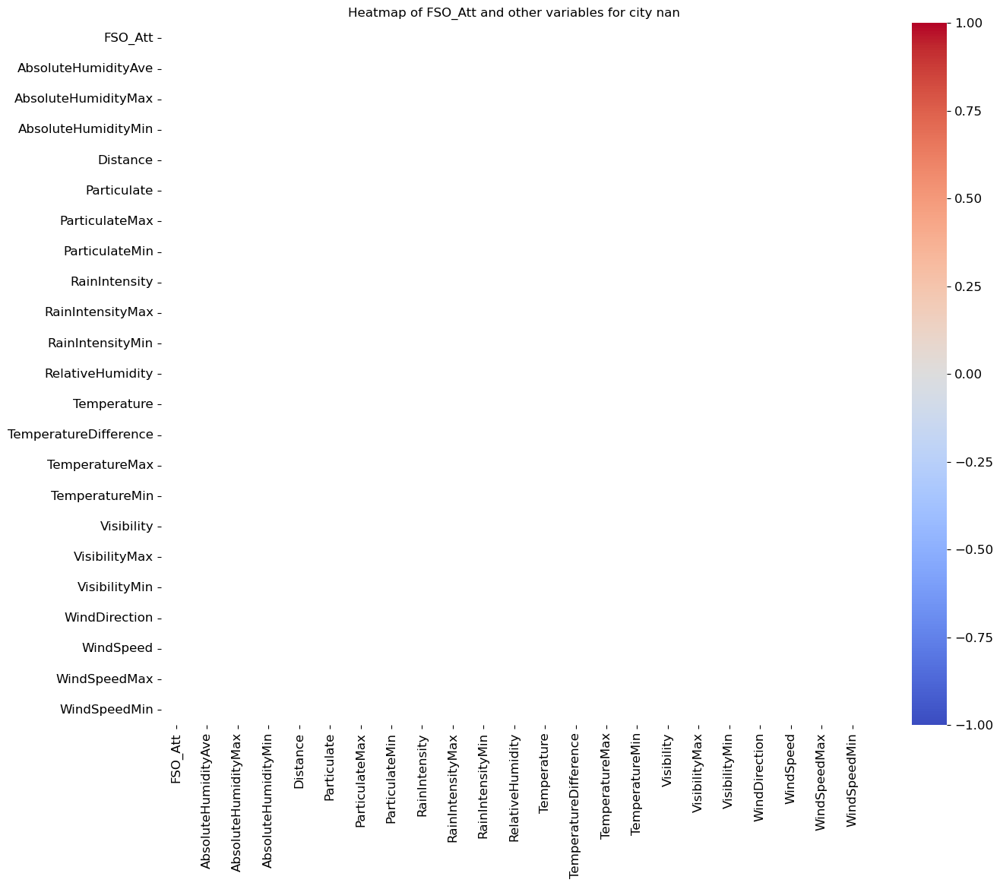

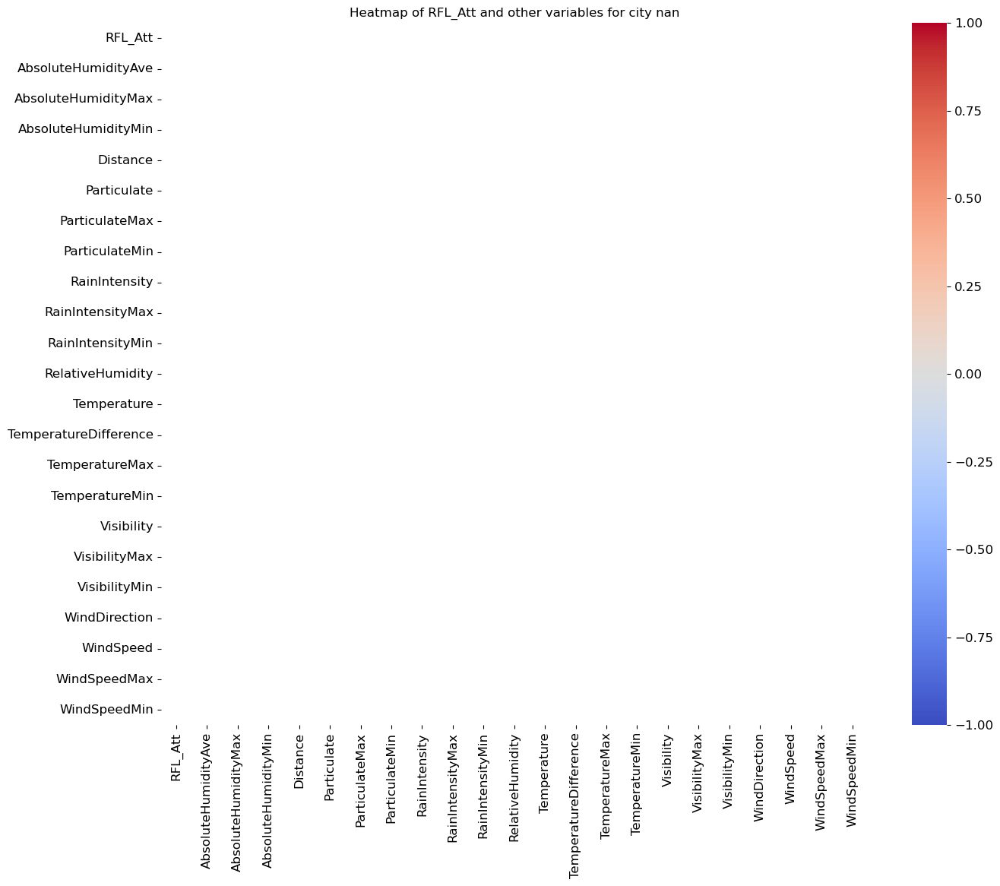

In [59]:
# Define the column groups for FSO_Att and RFL_Att separately
fso_columns = [
    'FSO_Att', 'AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin', 'Distance', 'Particulate', 
    'ParticulateMax', 'ParticulateMin', 'RainIntensity', 'RainIntensityMax', 'RainIntensityMin', 'RelativeHumidity', 
    'Temperature', 'TemperatureDifference', 'TemperatureMax', 'TemperatureMin', 'Visibility', 'VisibilityMax', 
    'VisibilityMin', 'WindDirection', 'WindSpeed', 'WindSpeedMax', 'WindSpeedMin'
]
rfl_columns = [
    'RFL_Att', 'AbsoluteHumidityAve', 'AbsoluteHumidityMax', 'AbsoluteHumidityMin', 'Distance', 'Particulate', 
    'ParticulateMax', 'ParticulateMin', 'RainIntensity', 'RainIntensityMax', 'RainIntensityMin', 'RelativeHumidity', 
    'Temperature', 'TemperatureDifference', 'TemperatureMax', 'TemperatureMin', 'Visibility', 'VisibilityMax', 
    'VisibilityMin', 'WindDirection', 'WindSpeed', 'WindSpeedMax', 'WindSpeedMin'
]

# Define the function to create heatmaps for each city and variable group
def plot_heatmap_for_city(city_data, columns, title):
    # Compute the correlation matrix
    corr = city_data[columns].corr()
    
    # Generate the heatmap
    plt.figure(figsize=(15, 12))
    sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1)
    plt.title(title)
    plt.show()

# Define the range breakpoints for "Distance"
bins = [0, 2050, 2400, 2700, 3700, 4500, data_clean['Distance'].max()]

# Segment the Distance into bins and label them
data_clean['City'] = pd.cut(data_clean['Distance'], bins=bins, right=False, labels=["2000-2050", "2050-2400", "2400-2700", "2700-3700", "3700-4500", "4500+"])

# Get unique city labels
unique_cities = data_clean['City'].unique()

# Plot heatmaps for each city and each variable group
for city_label in unique_cities:
    city_data = data_clean[data_clean['City'] == city_label]
    
    plot_heatmap_for_city(city_data, fso_columns, f'Heatmap of FSO_Att and other variables for city {city_label}')
    plot_heatmap_for_city(city_data, rfl_columns, f'Heatmap of RFL_Att and other variables for city {city_label}')

We can see that a large number of variables are significantly correlated. We set the threshold as the lowest correlation indicator for Windspeed and WindspeedMax in 2700-3700 with a correlation of 0.68 and correlated variables above the threshold are the redundant variables we need to consider. Variables with a correlation of 1 have consistent data characteristics, so AbsoluteHumidity is retained in AbsoluteHumidity, AveAbsoluteHumidityMax and AbsoluteHumidityMin; Particulate in Particulate, ParticulateMax and Particulate in Particulate, ParticulateMax and ParticulateMin; RainIntensity in RainIntensity, RainIntensityMax and RainIntensityMin; Temperature in Temperature, TemperatureMax and TemperatureMin. Temperature will be retained in Temperature, TemperatureMax and TemperatureMin; Visibility will be retained in Visibility, VisibilityMax and VisibilityMin; and WindSpeed will be retained in WindSpeed, WindSpeedMax and WindSpeedMin. We will remove all other redundant variable records.

In [60]:
# Save the cleaned data to the specified local path
local_path = r"C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\data_clean.csv"

# Attempt to save the file locally
data_clean.to_csv(local_path, index=False)

print(f"The cleaned data has been saved to: {local_path}")


The cleaned data has been saved to: C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\data_clean.csv


In [61]:
# Define the path to the saved data_clean.csv
input_path = r"C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\data_clean.csv"

# Load the data from the saved data_clean.csv
data = pd.read_csv(input_path)

# Keep only the specified columns
columns_to_keep = [
    'FSO_Att', 'RFL_Att', 'AbsoluteHumidityAve', 'Distance', 'Frequency',
    'Particulate', 'RainIntensity', 'RelativeHumidity', 'SYNOPCode',
    'Temperature', 'TemperatureDifference', 'Time', 'Visibility',
    'WindDirection', 'WindSpeed'
]

# Check if all specified columns exist in the dataset
missing_columns = [col for col in columns_to_keep if col not in data.columns]
if missing_columns:
    raise ValueError(f"Missing columns in the dataset: {missing_columns}")

# Create a subset of the data with the specified columns
filtered_data = data[columns_to_keep]

# Define the output path for cleaned_data.csv
output_path = r"C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data.csv"

# Save the filtered data to cleaned_data.csv with UTF-8 encoding
filtered_data.to_csv(output_path, index=False, encoding='utf-8-sig')

print(f"The filtered data has been saved to: {output_path}")


The filtered data has been saved to: C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data.csv


As the above data cleaning process took a very long time according to the city, we split the cleaned dataset into 6 parts and saved them in a new Excel dataset file.

In [62]:
# Define the path to the cleaned_data.csv
input_path = r"C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data.csv"

# Load the cleaned data
data_clean = pd.read_csv(input_path)

# Define the original bin ranges
bins = [0, 2050, 2400, 2700, 3700, 4500, data_clean['Distance'].max()]
labels = ["2000-2050", "2050-2400", "2400-2700", "2700-3700", "3700-4500", "4500+"]

# Create the 'City' column based on the original bins
data_clean['City'] = pd.cut(data_clean['Distance'], bins=bins, labels=labels, right=False)

# Verify the unique city labels
unique_cities = data_clean['City'].unique()
print("Unique City Labels:", unique_cities)

# Define the output directory
output_dir = r"C:\Users\sylph\Desktop\数据中心\UOA\ResearchA"

# Save a new dataset for each city
for city_label in unique_cities:
    city_data = data_clean[data_clean['City'] == city_label]
    output_path = os.path.join(output_dir, f'cleaned_data_city_{city_label}.csv')
    city_data.to_csv(output_path, index=False, encoding='utf-8-sig')
    print(f'Data for city {city_label} saved to {output_path}')


Unique City Labels: ['2000-2050', '2050-2400', '2400-2700', '2700-3700', '3700-4500', '4500+', NaN]
Categories (6, object): ['2000-2050' < '2050-2400' < '2400-2700' < '2700-3700' < '3700-4500' < '4500+']
Data for city 2000-2050 saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_2000-2050.csv
Data for city 2050-2400 saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_2050-2400.csv
Data for city 2400-2700 saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_2400-2700.csv
Data for city 2700-3700 saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_2700-3700.csv
Data for city 3700-4500 saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_3700-4500.csv
Data for city 4500+ saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_4500+.csv
Data for city nan saved to C:\Users\sylph\Desktop\数据中心\UOA\ResearchA\cleaned_data_city_nan.csv
